# EDA временного ряда <a class="tocSkip">

При подготовке к прогнозированию ВР важно проверить наличие:

    1. Тренда
    2. Сезонности
    3. Резкого изменения поведения в вр
    4. Выбросов

В этом ноутбуке мы рассмотрим различные примеры нестационарных рядов, а также способы приведения исходного нестационарного ряда к стационарному. Основные причины нестационарности приведены на рисунке ниже:

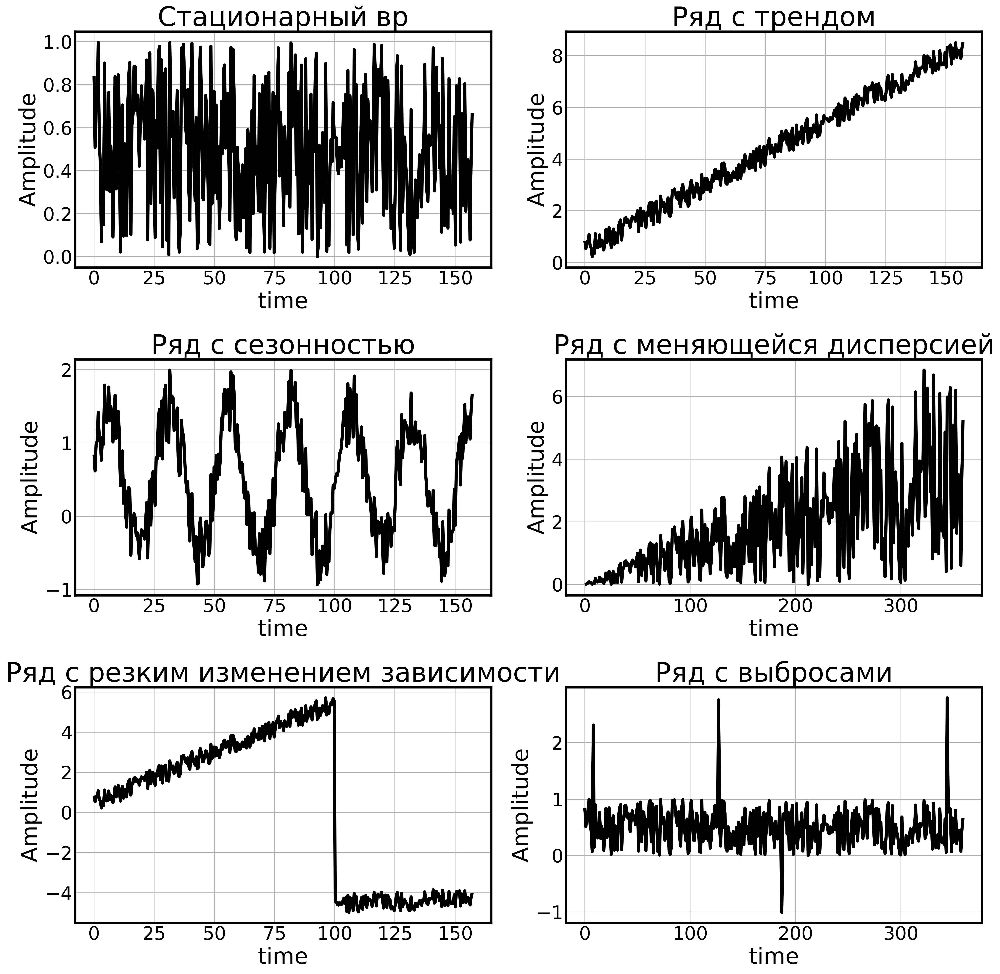

In [1]:
import matplotlib.pyplot as plt
import seaborn as sns

import numpy as np
import pandas as pd
import warnings
warnings.filterwarnings("ignore")
import statsmodels.api as sm
from scipy import stats

In [2]:
params = {'lines.linewidth': 4,
          'lines.solid_capstyle': 'butt',
          'axes.labelsize': 'large',
          'axes.axisbelow': True,
          'axes.grid': True,
          'axes.linewidth': 3.0,
          'axes.titlesize': 'x-large',
          'grid.linestyle': '-',
          'grid.linewidth': 1.0,
          'xtick.major.size': 0,
          'xtick.minor.size': 0,
          'ytick.major.size': 0,
          'ytick.minor.size': 0,
          'figure.subplot.left': 0.08,
          'figure.subplot.right': 0.95,
          'figure.subplot.bottom': 0.07,
          'figure.figsize': (10.8, 7.8),
          'figure.autolayout': True,
          'figure.dpi': 300,
          'font.size': 24.0 }
plt.rcParams.update(params)

In [3]:
pd.options.display.max_rows = 999

In [4]:
%cd ..
%env PYTHONPATH=.

/home/dssaburi/projects/teta
env: PYTHONPATH=.


# Визуальный анализ ряда

Самый первый шаг, который рекомендуется сделать - это провести визуальный анализ ВР. 

## ВВП России

In [5]:
gdp = pd.read_csv("data/russia-gdp-gross-domestic-product.csv")

In [6]:
gdp.head()

,date,GDP ( Billions of US $),Per Capita (US $),Annual % Change
0,1988-12-31,554.713455,3777.2354,NaN
1,1989-12-31,506.500174,3428.7622,NaN
2,1990-12-31,516.814274,3492.7102,-3.0000
3,1991-12-31,517.962963,3490.4524,-5.0469
4,1992-12-31,460.290557,3098.8027,-14.5311


In [7]:
gdp['date'] = pd.to_datetime(gdp['date'])
gdp.set_index('date',inplace=True) # задаем дату в качестве индекса

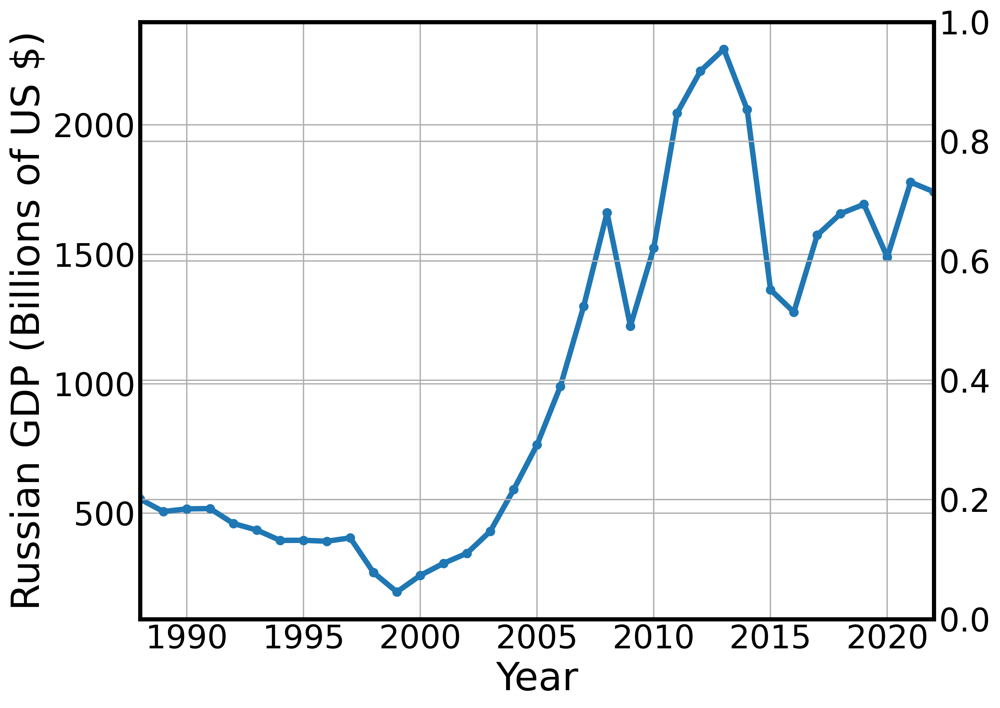

In [8]:
ax = gdp.plot(y=' GDP ( Billions of US $)', legend=False,marker='o')
ax.set_ylabel('Russian GDP (Billions of US $)')
ax1 = ax.twinx()
ax.set_xlabel('Year')
plt.xticks(rotation=90);

## Солнечные пятна

In [9]:
Sun = pd.read_csv('data/sun.csv')
Sun['YEAR'] = pd.to_datetime(Sun['YEAR'].astype(int).astype(str) + '-01-01')
Sun.set_index("YEAR",inplace=True)

In [10]:
Sun.tail()

,SUNACTIVITY
YEAR,
2004-01-01,40.4
2005-01-01,29.8
2006-01-01,15.2
2007-01-01,7.5
2008-01-01,2.9


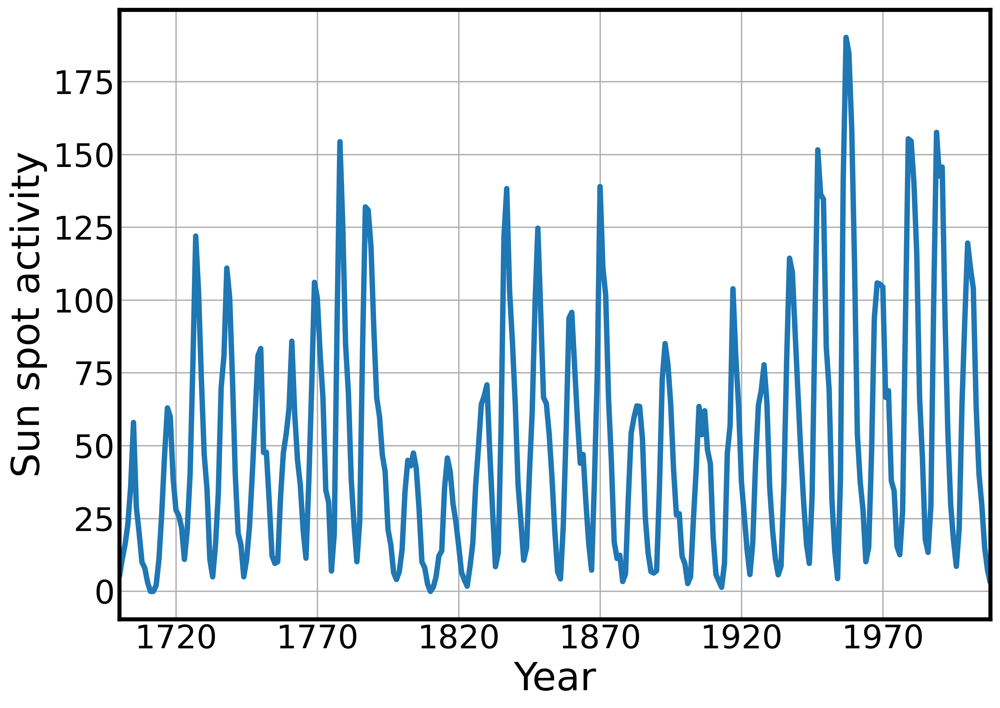

In [11]:
ax = Sun.plot( legend=False)
ax.set_ylabel('Sun spot activity')
ax.set_xlabel('Year');

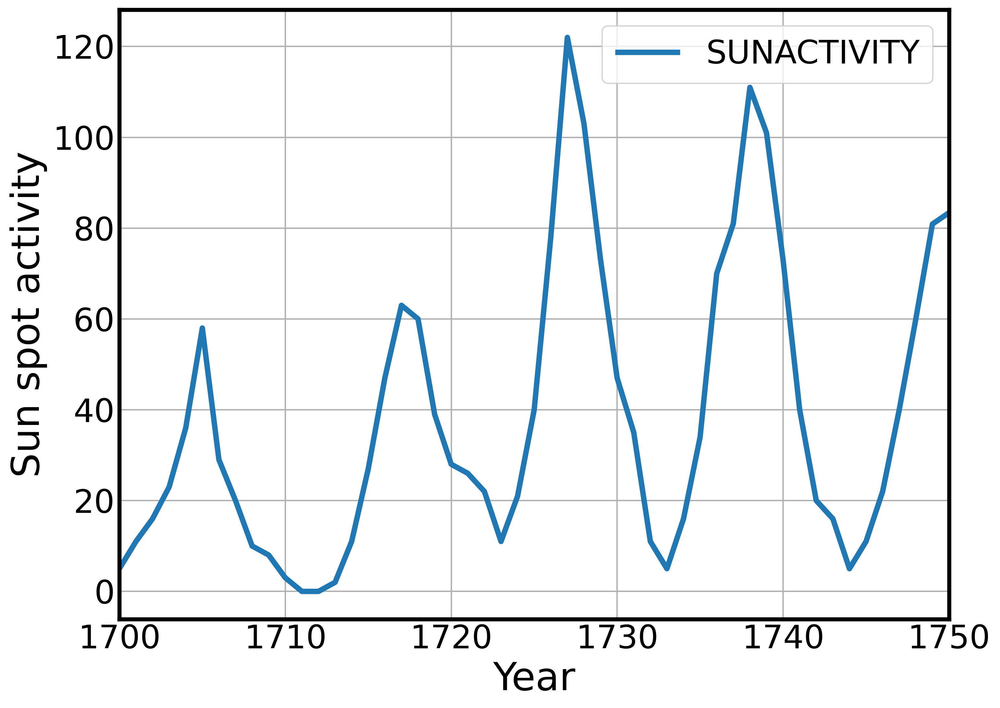

In [12]:
ax = Sun.iloc[:51,:].plot()
ax.set_ylabel('Sun spot activity')
ax.set_xlabel('Year');

## Количество пассажиров на международных рейсах

In [13]:
airline = pd.read_csv('data/international-airline-passengers.csv', sep=';')
airline['Month'] = pd.to_datetime(airline['Month']+'-01')
airline.set_index('Month', inplace=True)

In [168]:
airline.head()

,Passengers
Month,
1949-01-01,112
1949-02-01,118
1949-03-01,132
1949-04-01,129
1949-05-01,121


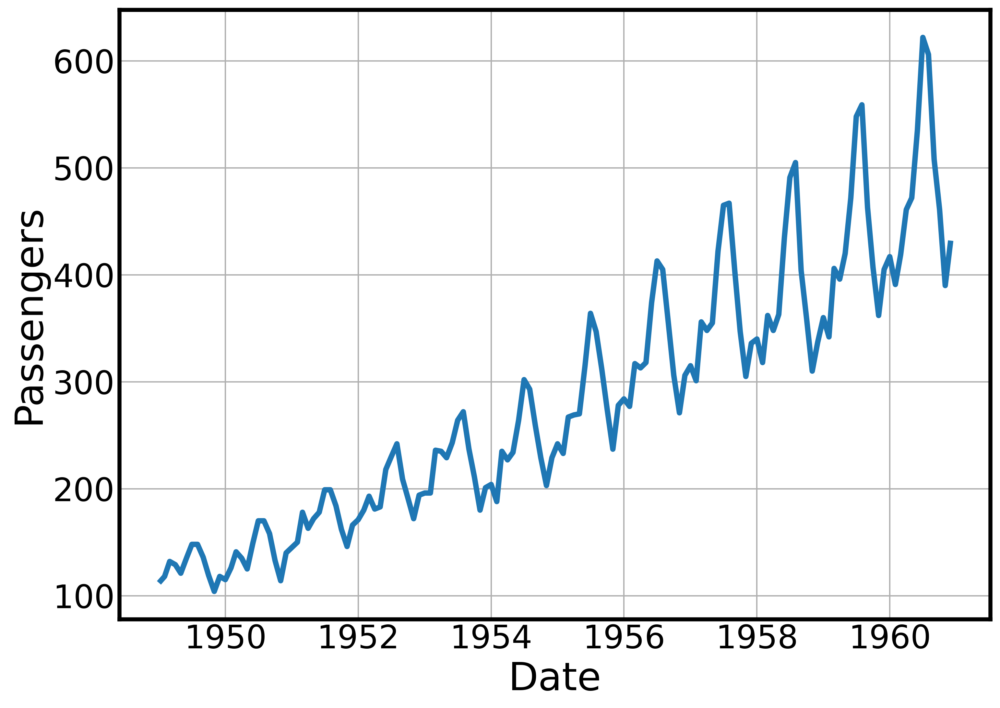

In [167]:
fig, ax = plt.subplots(1, 1)
ax.plot(airline.index, airline['Passengers'])
ax.set_xlabel('Date')
ax.set_ylabel('Passengers');

## Температурные данные – гора Вашингтон, Нью-Хэмпшир

Содержит ежедневные минимальные температуры по сухому термометру (°F), зарегистрированные на вершине горы Вашингтон в Нью-Гэмпшире за четыре года с 1 декабря 2014 г. по 30 ноября 2018 г. 

In [16]:
temps = pd.read_csv('data/MtWashingtonDailyTemps.csv',index_col='DATE',parse_dates=True)
temps.index.freq = 'D'
temps.head()

,MinTemp,MaxTemp,AvgTemp,AvgWindSpeed,Sunrise,Sunset
DATE,,,,,,
2014-12-01,3,36,20,65.1,700,1608
2014-12-02,1,22,12,34.7,702,1607
2014-12-03,8,32,20,53.0,703,1607
2014-12-04,-5,9,2,60.2,704,1607
2014-12-05,6,17,12,30.5,705,1607


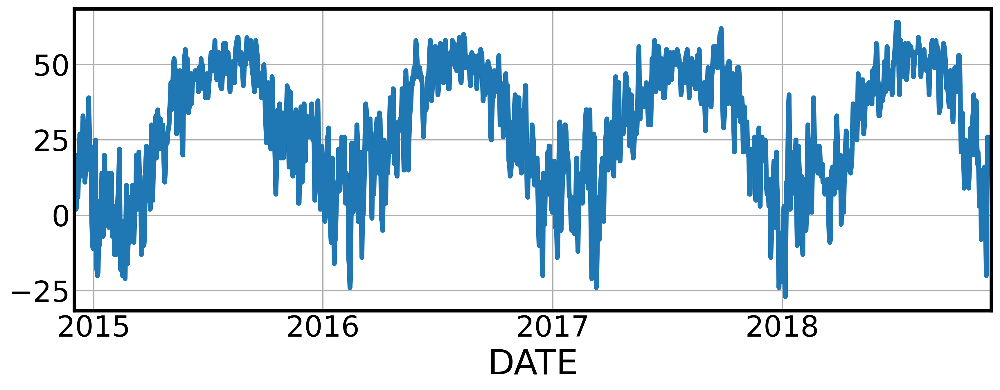

In [17]:
temps['AvgTemp'].plot(figsize=(12,5));

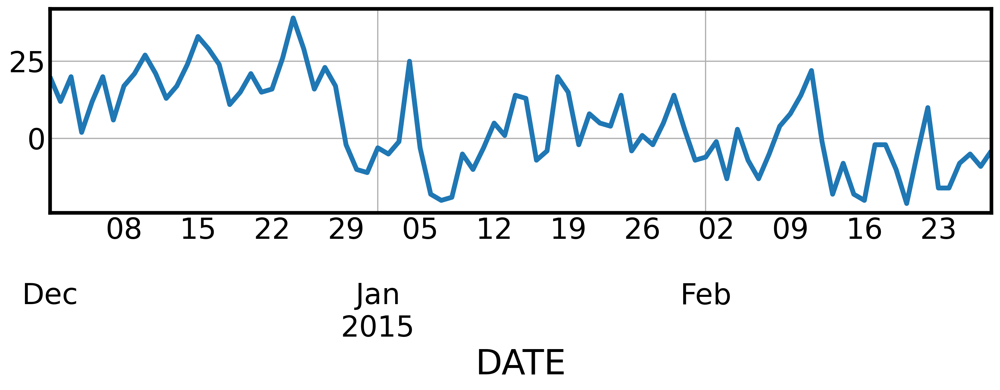

In [18]:
temps.iloc[:90,:]['AvgTemp'].plot(figsize=(12,5));

## Среднегодовой сток реки Рейн около Базеля, Швейцария, 1807–1957 гг. (150 записей)

In [19]:
river = pd.read_csv('data/rhine_river_discharge.csv',index_col='Year',parse_dates=True)
river.index.freq = 'AS'
river.head()

,Discharge
Year,
1807-01-01,864.884
1808-01-01,1033.141
1809-01-01,826.923
1810-01-01,1018.777
1811-01-01,1118.296


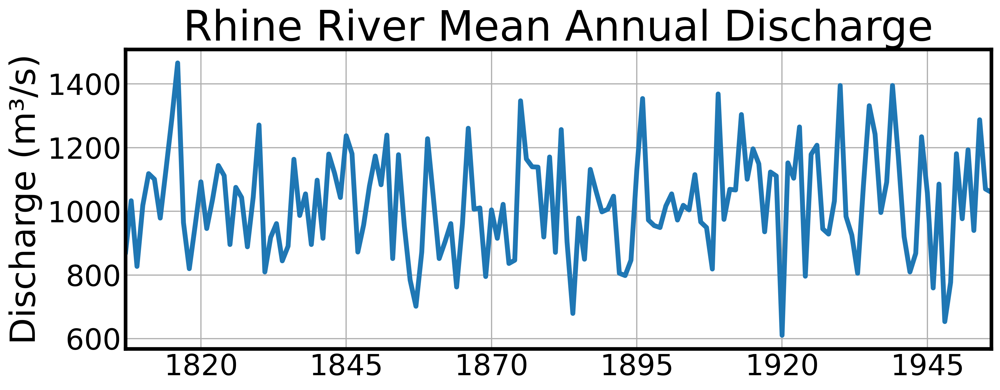

In [20]:
title = 'Rhine River Mean Annual Discharge'
ylabel='Discharge (m³/s)'
xlabel='' # we don't really need a label here

ax = river['Discharge'].plot(figsize=(12,5),title=title)
ax.autoscale(axis='x',tight=True)
ax.set(xlabel=xlabel, ylabel=ylabel);

## Объем поставок производителей

Объем отгрузок производителей для всех отраслей обрабатывающей промышленности в миллионах долларов без учета сезонных колебаний. Ежемесячные данные с января 1992 г. по январь 2019 г. (325 записей).

In [21]:
shipment = pd.read_csv('data/UMTMVS.csv',index_col='DATE',parse_dates=True)
shipment.index.freq = 'MS'
shipment.head()

,UMTMVS
DATE,
1992-01-01,209438.0
1992-02-01,232679.0
1992-03-01,249673.0
1992-04-01,239666.0
1992-05-01,243231.0


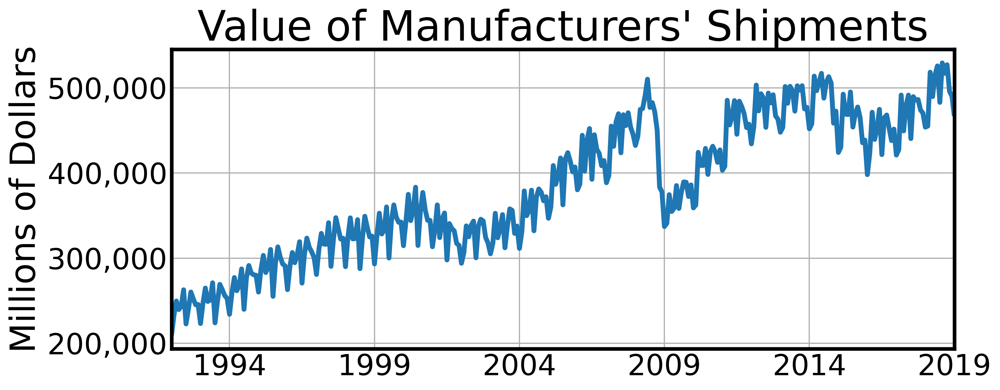

In [22]:
# HERE'S A TRICK TO ADD COMMAS TO Y-AXIS TICK VALUES
import matplotlib.ticker as ticker
formatter = ticker.StrMethodFormatter('{x:,.0f}')

title="Value of Manufacturers' Shipments" # be careful with quotes here!
ylabel='Millions of Dollars'
xlabel='' # we don't really need a label here

ax = shipment['UMTMVS'].plot(figsize=(12,5),title=title)
ax.autoscale(axis='x',tight=True)
ax.set(xlabel=xlabel, ylabel=ylabel)
ax.yaxis.set_major_formatter(formatter);

<Axes: title={'center': "Value of Manufacturers' Shipments"}, xlabel='DATE'>

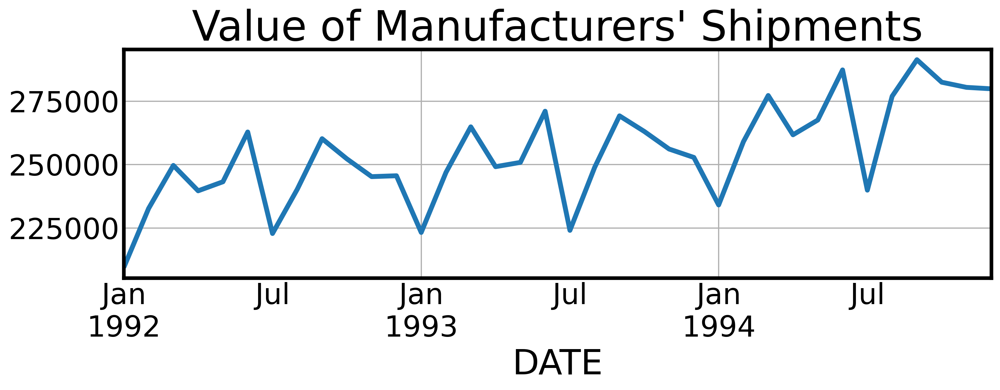

In [23]:
shipment.iloc[:36,:]['UMTMVS'].plot(figsize=(12,5),title=title)

## Продажи товаров салонов сотовой связи

In [24]:
df_items = pd.read_csv("data/example_dataset.csv",index_col='timestamp',parse_dates=True)

In [25]:
sales = df_items.pivot_table(index=df_items.index, columns='segment',values='target')

In [26]:
sales.head()

segment,segment_a,segment_b,segment_c,segment_d
timestamp,,,,
2019-01-01,170,102,92,238
2019-01-02,243,123,107,358
2019-01-03,267,130,103,366
2019-01-04,287,138,103,385
2019-01-05,279,137,104,384


(50.0, 350.0)

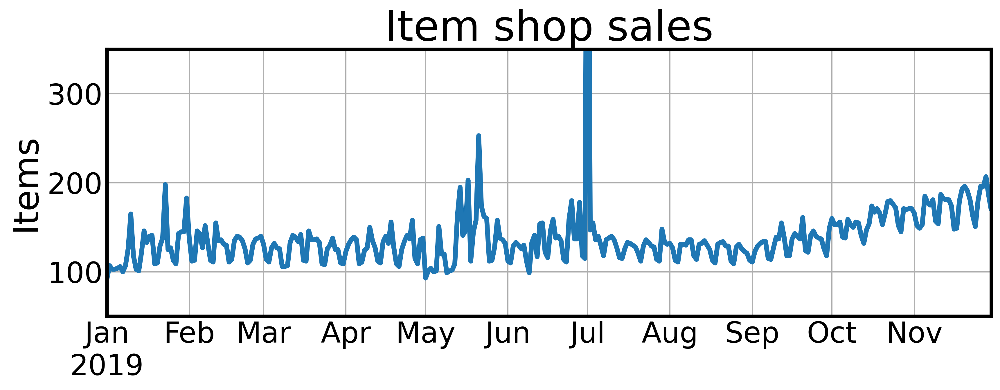

In [27]:
title = 'Item shop sales'
ylabel='Items'
xlabel='' # we don't really need a label here

ax = sales['segment_c'].plot(figsize=(12,5),title=title)
ax.autoscale(axis='x',tight=True)
ax.set(xlabel=xlabel, ylabel=ylabel);
plt.ylim(50,350)

# Инструменты выделения тренда

В этом разделе мы тестим различные варианты приведения временного ряда к стационарному на примере графика российского ВВП, который имеет довольно сложный нелинейный тренд

## Об экономических циклах

In [28]:
gdp = pd.read_csv("data/russia-gdp-gross-domestic-product.csv")

In [29]:
gdp['obs_num'] = gdp.reset_index()['index'] # переменная х для линейного тренда
gdp['date'] = pd.to_datetime(gdp['date'])
gdp.set_index('date',inplace=True) # задаем дату в качестве индекса
gdp['const'] = 1 # свободный член для линейного тренда

In [30]:
gdp.head()

,GDP ( Billions of US $),Per Capita (US $),Annual % Change,obs_num,const
date,,,,,
1988-12-31,554.713455,3777.2354,NaN,0,1
1989-12-31,506.500174,3428.7622,NaN,1,1
1990-12-31,516.814274,3492.7102,-3.0000,2,1
1991-12-31,517.962963,3490.4524,-5.0469,3,1
1992-12-31,460.290557,3098.8027,-14.5311,4,1


In [31]:
linear_trend_model = sm.OLS(gdp[' GDP ( Billions of US $)'],gdp[['obs_num','const']]).fit()

In [32]:
gdp['GDP TREND'] = linear_trend_model.predict(gdp[['obs_num','const']])

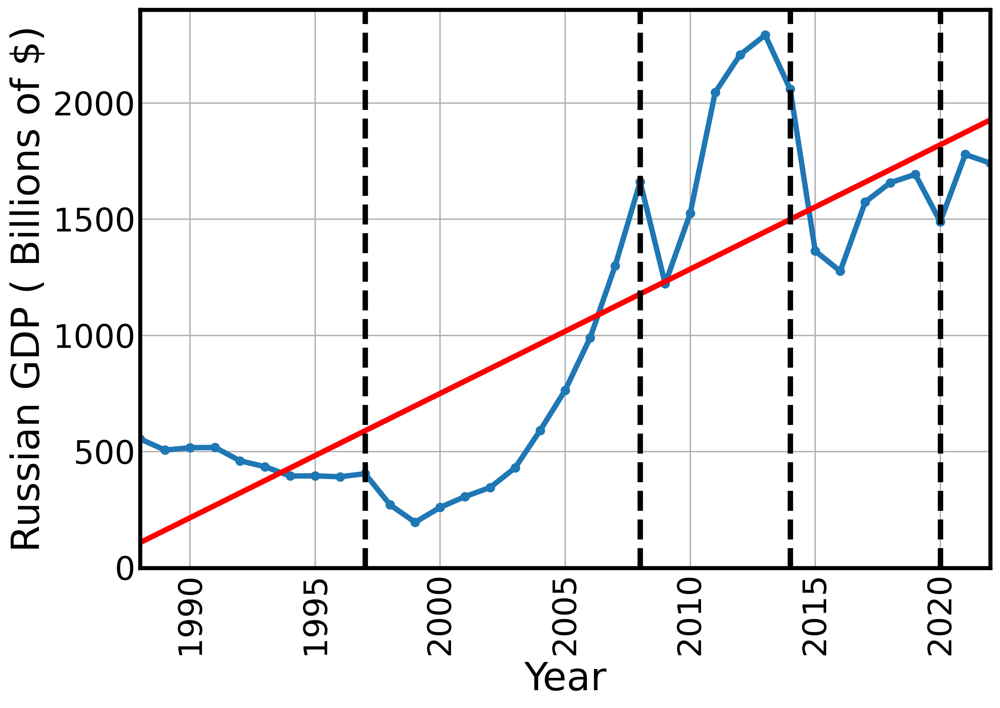

In [33]:
ax = gdp.plot(y=' GDP ( Billions of US $)', legend=False,marker='o')
gdp.plot(y='GDP TREND', legend=False,ax=ax,c='red')
ax.set_ylabel('Russian GDP ( Billions of $)')
ax.set_xlabel('Year')
plt.axvline(['1997-12-31'],c='black',linestyle='--')
plt.axvline(['2008-12-31'],c='black',linestyle='--')
plt.axvline(['2014-12-31'],c='black',linestyle='--')
plt.axvline(['2020-12-31'],c='black',linestyle='--')
plt.xticks(rotation=90);

## Приведение ряда к стационарному с помощью линейного тренда

### Построение детерменированной модели тренда: 

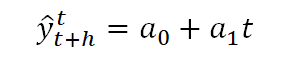

In [34]:
from scipy import signal
gdp[' GDP ( Billions of US $) detrend'] = signal.detrend(gdp[' GDP ( Billions of US $)'])

### Дифференцирование - Переход к попарным разностям (попарным отношениям) соседних значений

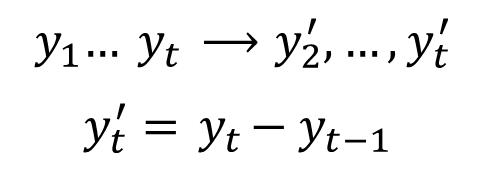
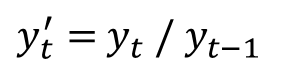

In [35]:
gdp[' GDP ( Billions of US $) diff'] = gdp[' GDP ( Billions of US $)'] - gdp[' GDP ( Billions of US $)'].shift(1)
gdp[' GDP ( Billions of US $) rel'] = gdp[' GDP ( Billions of US $)']/gdp[' GDP ( Billions of US $)'].shift(1) - 1

### Сглаживанием исходного ряда скользящим средним:

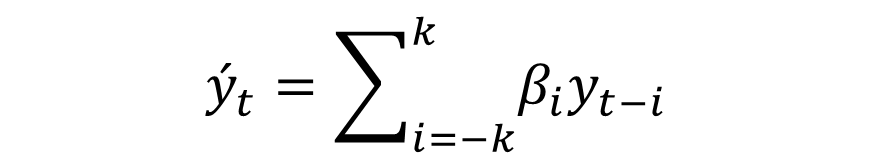

In [36]:
gdp[' GDP ( Billions of US $) smoothed'] = gdp[' GDP ( Billions of US $)'].rolling(5,center=True).mean()
gdp[' GDP ( Billions of US $) desmoothed'] = gdp[' GDP ( Billions of US $)'] - gdp[' GDP ( Billions of US $) smoothed']

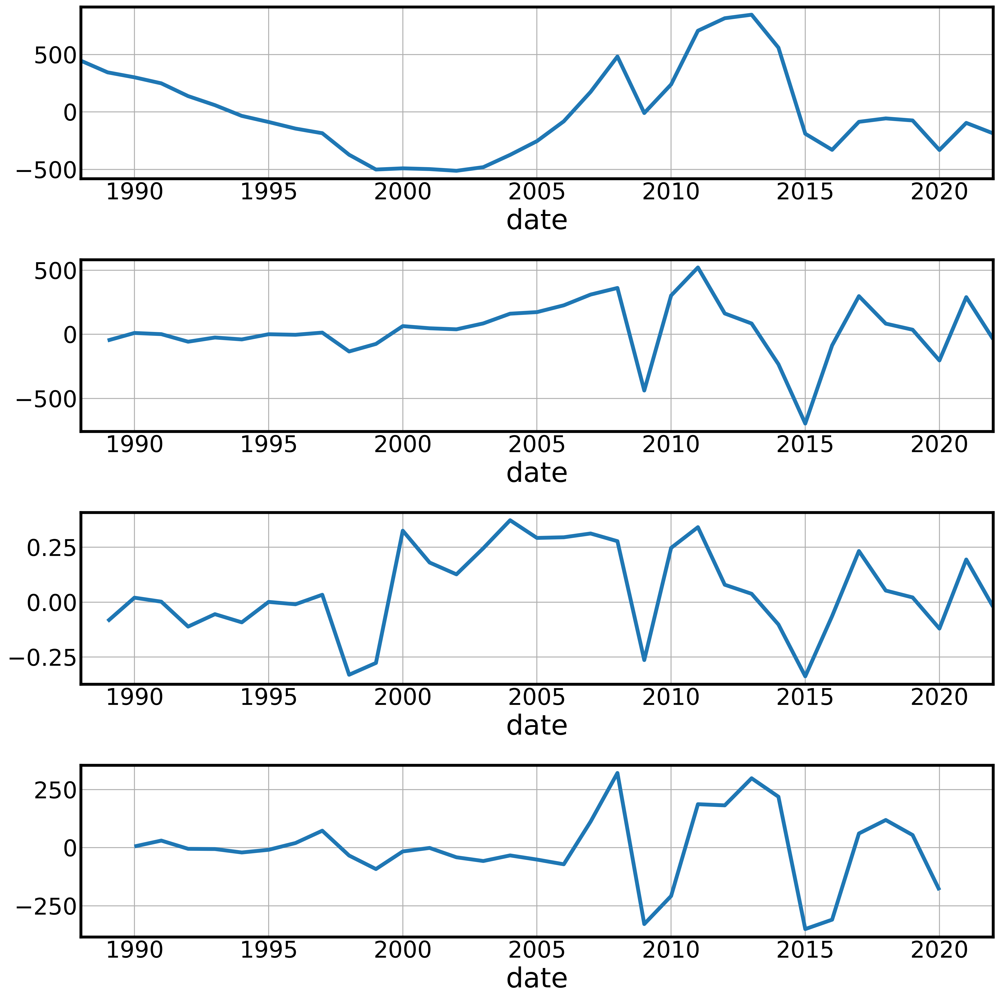

In [37]:
fig,ax = plt.subplots(4,1,figsize= (15,15)) 
gdp.plot(y=' GDP ( Billions of US $) detrend', legend=False,ax=ax[0])

gdp.plot(y=' GDP ( Billions of US $) diff', legend=False,ax=ax[1])
gdp.plot(y=' GDP ( Billions of US $) rel', legend=False,ax=ax[2])
gdp.plot(y=' GDP ( Billions of US $) desmoothed', legend=False,ax=ax[3]);

In [38]:
print(np.mean(gdp[' GDP ( Billions of US $) detrend']),np.std(gdp[' GDP ( Billions of US $) detrend'])/np.sqrt(len(gdp)))
print(np.mean(gdp[' GDP ( Billions of US $) diff']),np.std(gdp[' GDP ( Billions of US $) diff'])/np.sqrt(len(gdp)))
print(np.mean(gdp[' GDP ( Billions of US $) rel']),np.std(gdp[' GDP ( Billions of US $) rel'])/np.sqrt(len(gdp)))
print(np.mean(gdp[' GDP ( Billions of US $) desmoothed']),np.std(gdp[' GDP ( Billions of US $) desmoothed'])/np.sqrt(len(gdp)))

5.911715561524034e-13 63.687519196276085
34.90337457360382 37.75303712271803
0.05370316813277006 0.03327865764559888
-4.150173246194122 26.71881105354296


In [ ]:
gdp[' GDP ( Billions of US $) smoothed']

## Дополнительные инструменты выделения тренда

### Фильтр Ходрика-Прескотта

Фильтр Ходрика-Прескотта разделяет $y_t$ временного ряда на тренд $\tau_t$  и остаточный цикл $\zeta_t$,
    $$y_t = \tau_t + \zeta_t$$
Компоненты определяются путем минимизации следующей квадратичной функции потерь:
    $$\min_{\\{ \tau_{t}\\} }\sum_{t}^{T}\zeta_{t}^{2}+\lambda\sum_{t=1}^{T}\left[\left(\tau_{t}-\tau_{t-1}\right)-\left(\tau_{t-1}-\tau_{t-2}\right)\right]^{2}$$

In [58]:
cycle, trend = sm.tsa.filters.hpfilter(gdp[' GDP ( Billions of US $)'],lamb= 6.25)

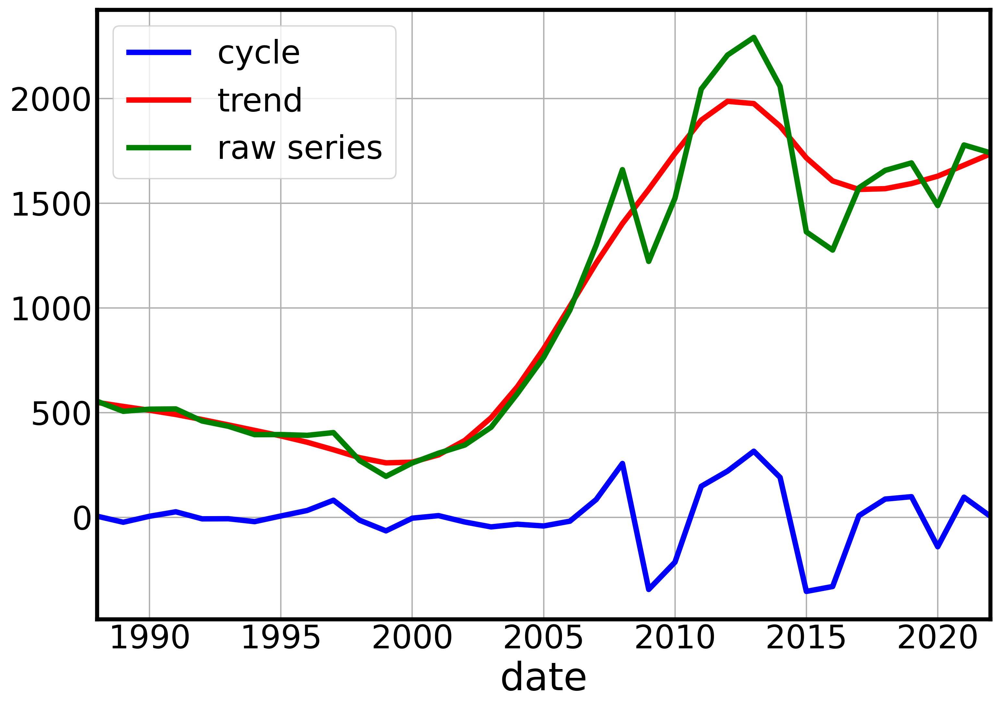

In [59]:
cycle.plot(c='blue',label='cycle')
trend.plot(c='red',label='trend')
gdp[' GDP ( Billions of US $)'].plot(c='green',label='raw series')
plt.legend();

### Сигмоидный тренд с насыщением

Сигмоидная модель моделирует тренд с насыщением. Попробуем обучить такую модель на наших данных с центром в середине ряда

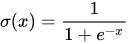

In [60]:
gdp['obs_num_sigm'] = 1/(1.+np.exp(-1*(gdp['obs_num']-18)))

In [61]:
linear_trend_model = sm.OLS(gdp[' GDP ( Billions of US $)'],gdp[['obs_num_sigm','const']]).fit()

In [46]:
gdp['GDP TREND SIGMOID'] = linear_trend_model.predict(gdp[['obs_num_sigm','const']])

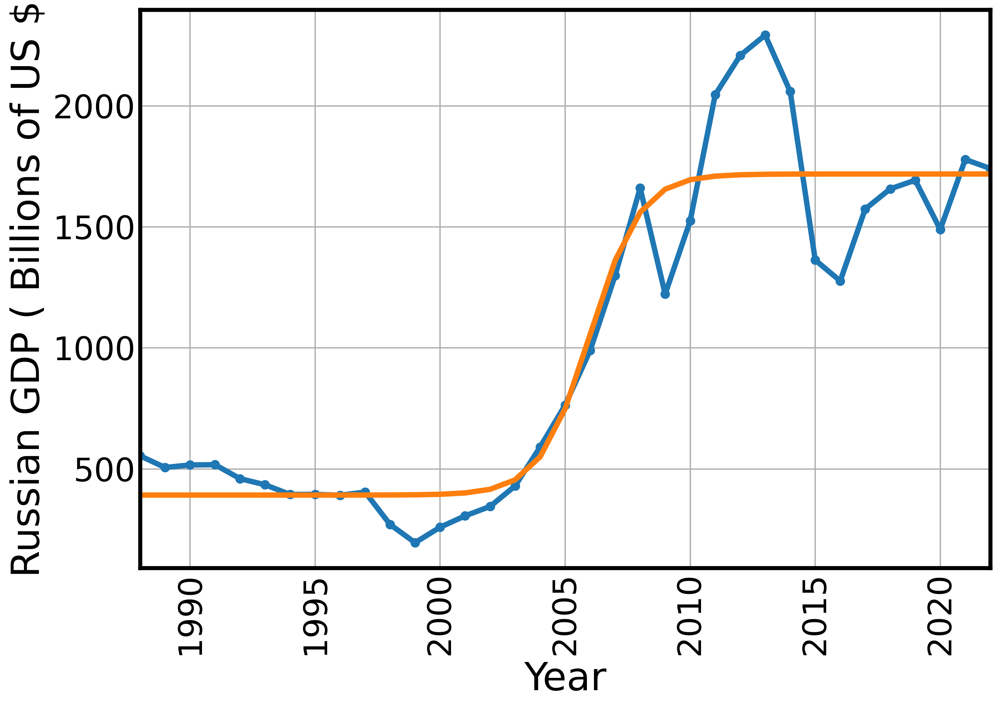

In [47]:
ax = gdp.plot(y=' GDP ( Billions of US $)', legend=False,marker='o')
gdp.plot(y='GDP TREND SIGMOID', legend=False,ax=ax)
ax.set_ylabel('Russian GDP ( Billions of US $')
ax.set_xlabel('Year')
plt.xticks(rotation=90);

### Кусочно-линейный тренд

Одна из наиболее удачных моделей для оценки тренда - кусочно-линейная. Идея простая: разбиваем исходный ряд на несколько отрезков, где сильно поменялась зависимость, и внутри каждого отрезка обучаем простую линейную регрессию

In [48]:
detrended_piecewise = signal.detrend(gdp[' GDP ( Billions of US $)'],bp=[15,24,30])
gdp['GDP TREND PIECE_LIN'] = gdp[' GDP ( Billions of US $)'] - detrended_piecewise

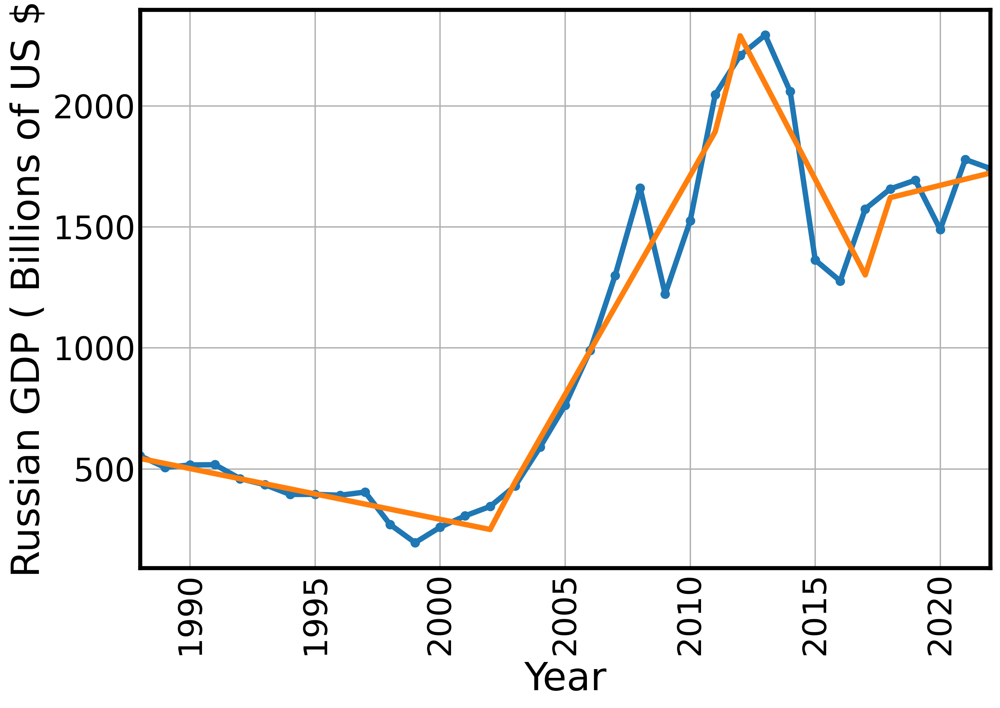

In [49]:
ax = gdp.plot(y=' GDP ( Billions of US $)', legend=False,marker='o')
gdp.plot(y='GDP TREND PIECE_LIN', legend=False,ax=ax)
ax.set_ylabel('Russian GDP ( Billions of US $')
ax.set_xlabel('Year')
plt.xticks(rotation=90);

### Сравнение полученных трендов

Сначала оценим результат визуально - построим графики трендов (левый столбец) и остатков (правый столбец)

<Axes: xlabel='date'>

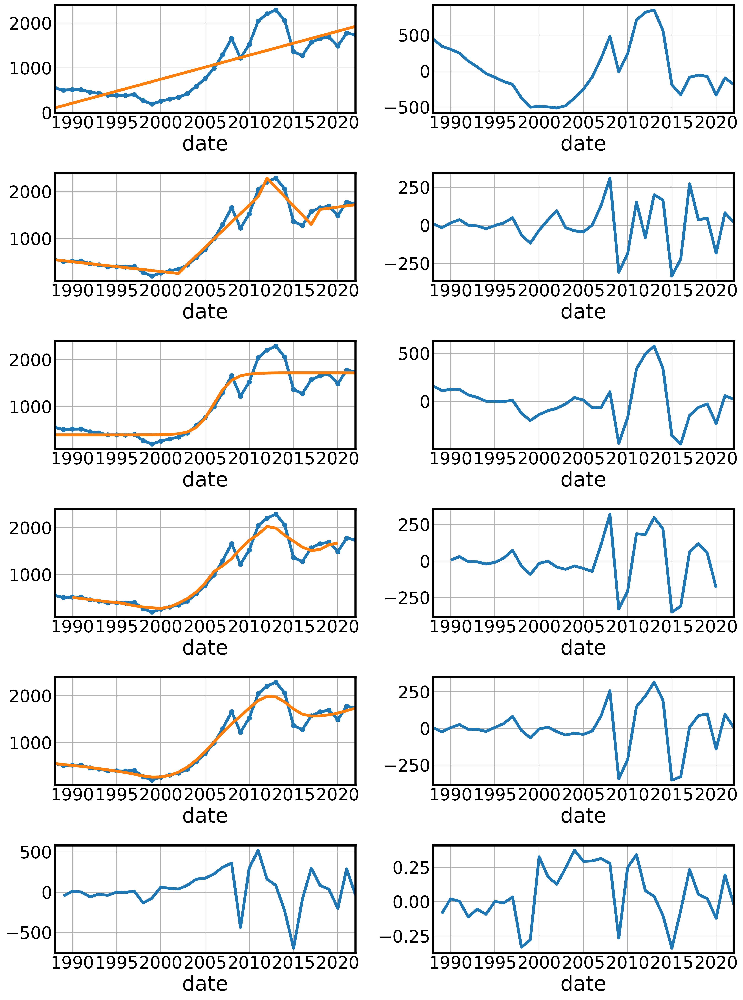

In [63]:
N_COLS = 2
trends_list = [gdp['GDP TREND'],
                gdp['GDP TREND PIECE_LIN'],
               gdp['GDP TREND SIGMOID'],
               gdp[' GDP ( Billions of US $) smoothed'],
               trend]

fig,ax = plt.subplots(len(trends_list)+1,N_COLS,figsize=(15,20))

for i,trend_est in enumerate(trends_list):
    gdp.plot(y=' GDP ( Billions of US $)', legend=False,marker='o',label='gdp',ax=ax[i][0])
    trend_est.plot(ax=ax[i][0])
    
    (gdp[' GDP ( Billions of US $)'] - trend_est).plot(ax=ax[i][1])

    
(gdp[' GDP ( Billions of US $) diff']).plot(ax=ax[len(trends_list)][0])
(gdp[' GDP ( Billions of US $) rel']).plot(ax=ax[len(trends_list)][1])

Если смотреть на графики остатков, то лучше всего с операцией детрендирования справляется операция дифференцирования отношением (самый нижний график), т.к. для остальных алгоритмов остатки имеют более выраженную гетероскедастичность - дисперсия остатков растет со временем


Сравним прогноз по моделям тренда с фактами

In [64]:
from sklearn.metrics import mean_absolute_error, r2_score,mean_squared_error, mean_squared_log_error

In [65]:
metrics = [mean_absolute_error, r2_score,mean_squared_error, mean_squared_log_error]

In [66]:
cm = sns.light_palette("green", as_cmap=True,reverse=True,)
error_df = pd.DataFrame([[metr(gdp[tren.notna()][' GDP ( Billions of US $)'],
       tren[tren.notna()]) for metr in metrics] for tren in trends_list],
            index=[tren.name for tren in trends_list],
            columns=[metr.__name__ for metr in metrics])

error_df.style.background_gradient(cmap=cm)

,mean_absolute_error,r2_score,mean_squared_error,mean_squared_log_error
GDP TREND,306.682526,0.672896,141963.503548,0.362024
GDP TREND PIECE_LIN,95.525718,0.956717,18784.933452,0.019964
GDP TREND SIGMOID,150.682879,0.894212,45911.876030,0.050949
GDP ( Billions of US $) smoothed,112.848446,0.943019,25003.544182,0.017714
GDP ( Billions of US $)_trend,96.102581,0.950937,21293.258304,0.012960


Лучшее качество показывает кусочно-линейный тренд с 3 точками излома. Но тут нужно быть аккуратнее - большое кол-во точек излома ведет к переобучению

Также оценим остатки на стационарность по критериям дики-фуллера и кпсс

In [67]:
from statsmodels. tsa.stattools import adfuller, kpss

In [68]:
stattests = [adfuller,kpss]
remains =   [(gdp[' GDP ( Billions of US $)'] - trend_est).dropna()
              for trend_est in trends_list] + \
            [gdp[' GDP ( Billions of US $) diff'].dropna(),
             gdp[' GDP ( Billions of US $) rel'].dropna()]

ramains_name = [trend_est.name for trend_est in trends_list] + ['diff','rel']

In [69]:
remains[0].name

In [70]:
error_df = pd.DataFrame([[metr(tren)[1] for metr in stattests] for tren in remains],
            index=ramains_name,
            columns=[metr.__name__ for metr in stattests])

error_df

/tmp/ipykernel_2977705/3958534635.py:1: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  error_df = pd.DataFrame([[metr(tren)[1] for metr in stattests] for tren in remains],
/tmp/ipykernel_2977705/3958534635.py:1: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  error_df = pd.DataFrame([[metr(tren)[1] for metr in stattests] for tren in remains],
/tmp/ipykernel_2977705/3958534635.py:1: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  error_df = pd.DataFrame([[metr(tren)[1] for metr in stattests] for tren in remains],
/tmp/ipykernel_2977705/3958534635.py:1: InterpolationWarning: The test statistic is outside of the range of p-values a

,adfuller,kpss
GDP TREND,0.169918,0.1
GDP TREND PIECE_LIN,0.000002,0.1
GDP TREND SIGMOID,0.000578,0.1
GDP ( Billions of US $) smoothed,0.000043,0.1
GDP ( Billions of US $)_trend,0.000007,0.1
diff,0.000134,0.1
rel,0.002372,0.1


Для линейного тренда критерий дики-фулера не отвергает гипотезу о нестационарности - остатки нестационарны. Остальные остатки стационарны


# Инструменты выделения сезонности

## EDA сезонных компонент

Не всегда понятно, присутствует ли сезонность в ряде данных. Помогают разобраться с этим вопросом,  несколько полезных графиков, которые мы дальше рассмотрим

### Автокореляционная функция

Первый вид графиков - графики автокореляционных функций

In [71]:
from statsmodels.graphics import tsaplots

<Axes: xlabel='YEAR'>

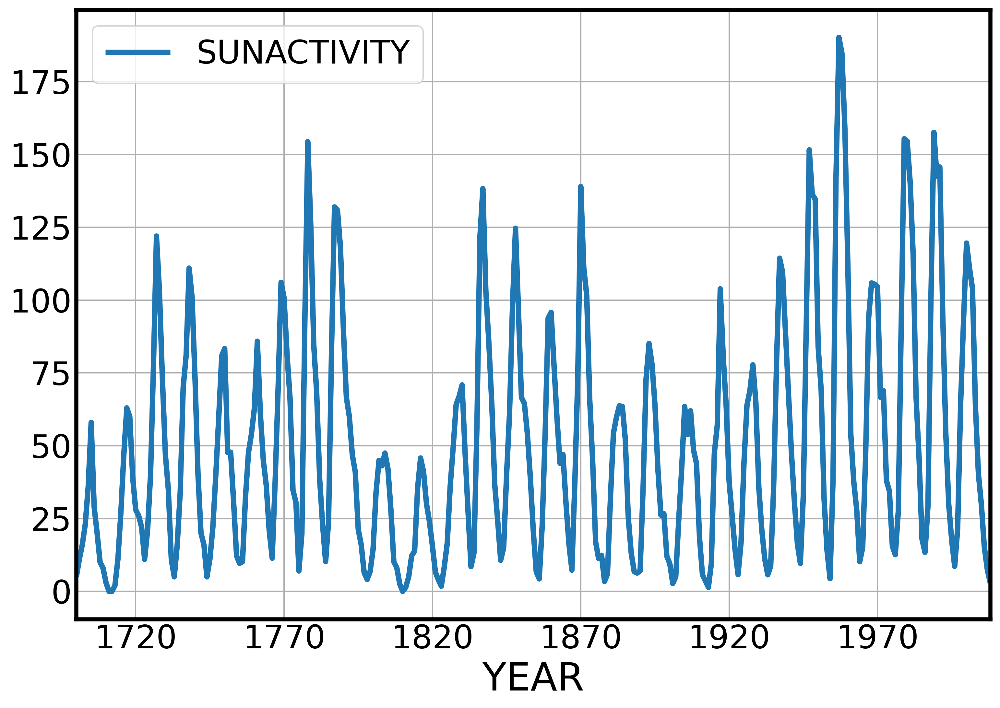

In [72]:
Sun.plot()

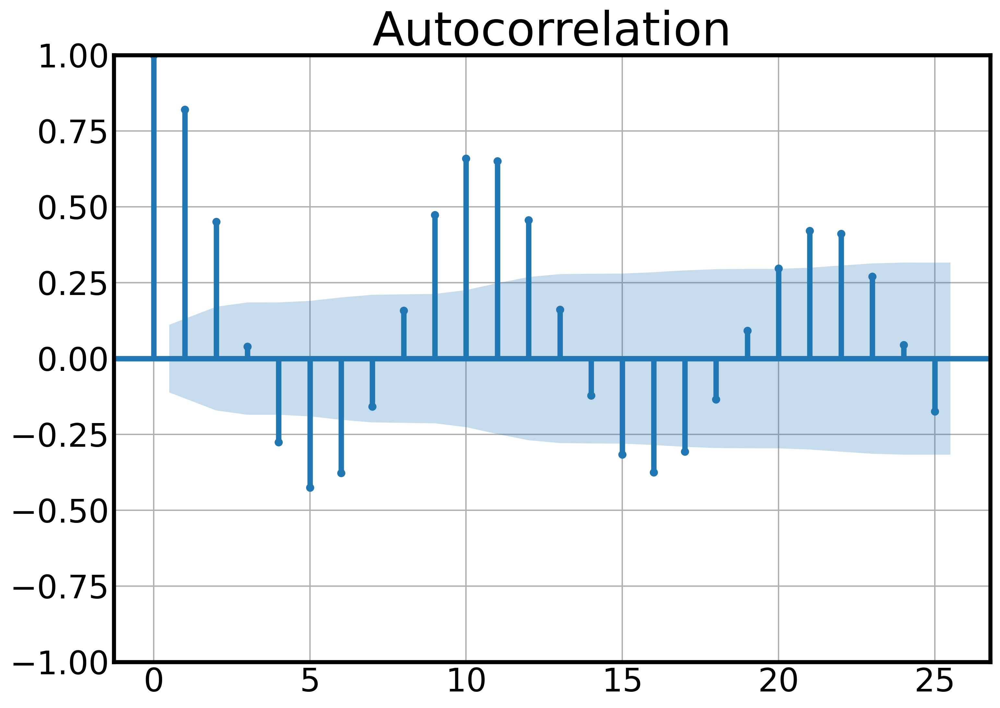

In [73]:
tsaplots.plot_acf(Sun);

In [74]:
temps = pd.read_csv('data/MtWashingtonDailyTemps.csv',index_col='DATE',parse_dates=True)
temps.index.freq = 'D'
temps.head()

,MinTemp,MaxTemp,AvgTemp,AvgWindSpeed,Sunrise,Sunset
DATE,,,,,,
2014-12-01,3,36,20,65.1,700,1608
2014-12-02,1,22,12,34.7,702,1607
2014-12-03,8,32,20,53.0,703,1607
2014-12-04,-5,9,2,60.2,704,1607
2014-12-05,6,17,12,30.5,705,1607


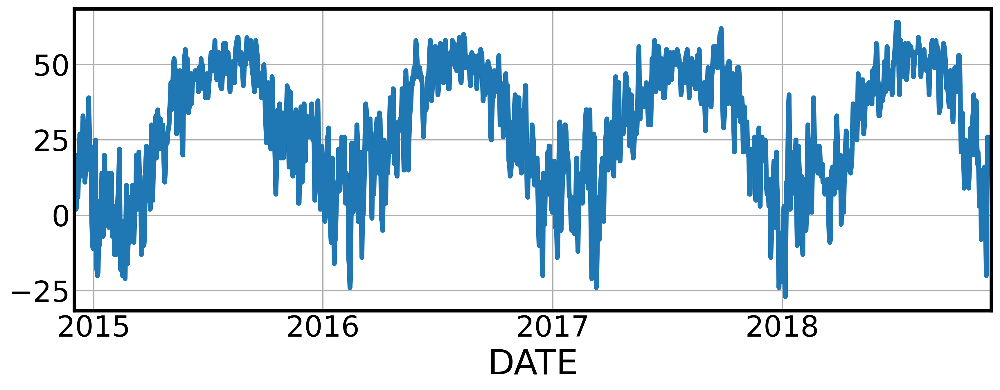

In [75]:
temps['AvgTemp'].plot(figsize=(12,5));

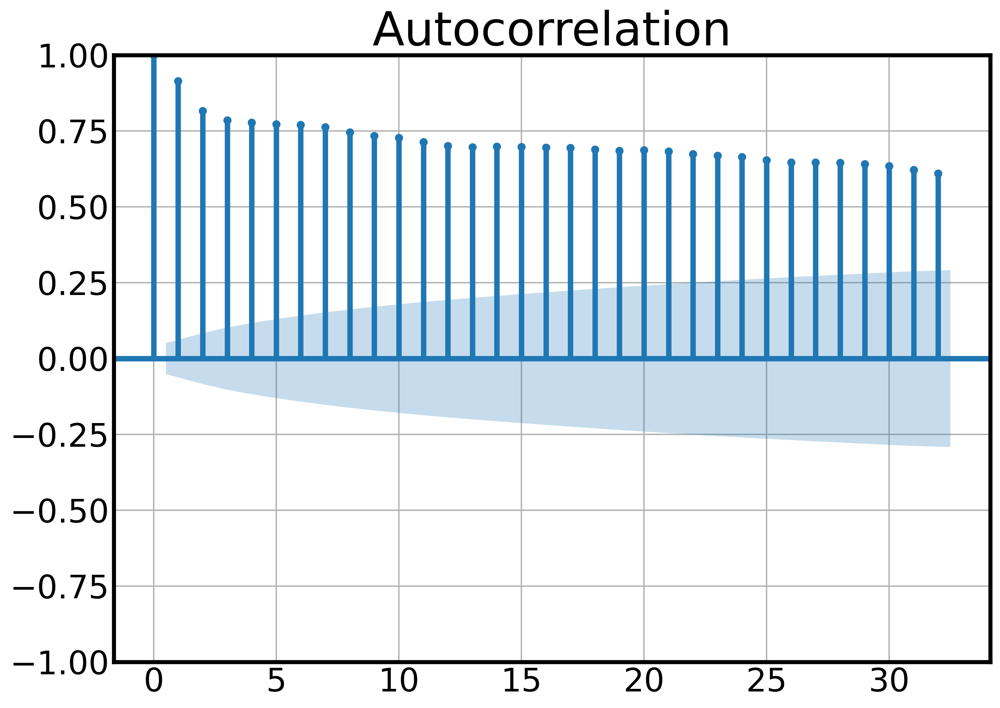

In [76]:
tsaplots.plot_acf(temps['AvgTemp']);

In [77]:
tempsm = temps['AvgTemp'].resample('M').mean()

<Axes: xlabel='DATE'>

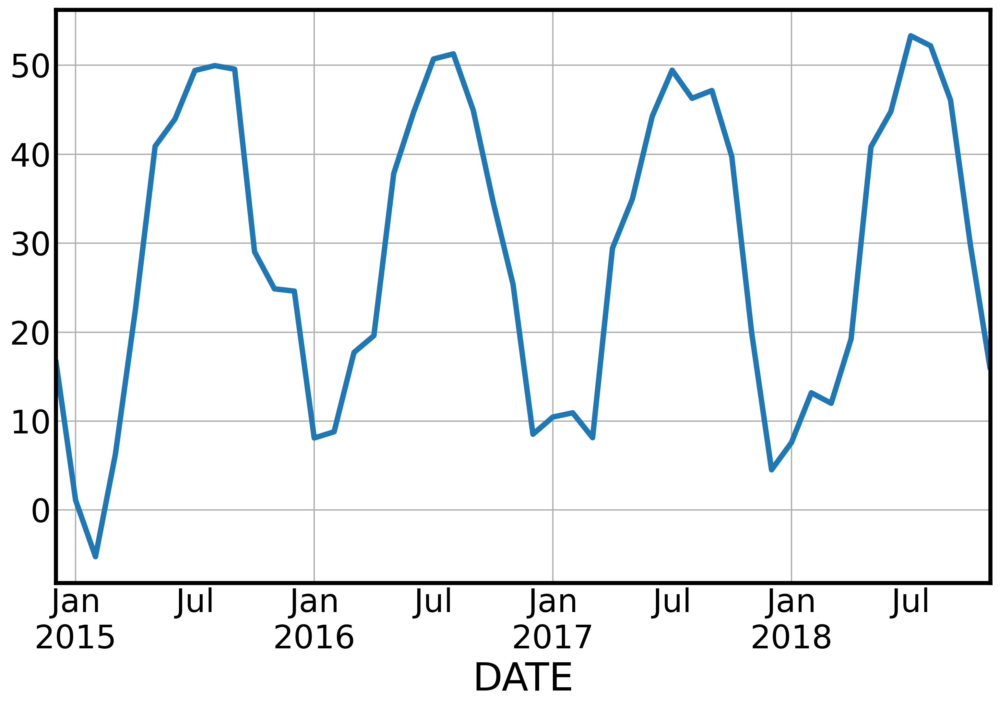

In [78]:
tempsm.plot()

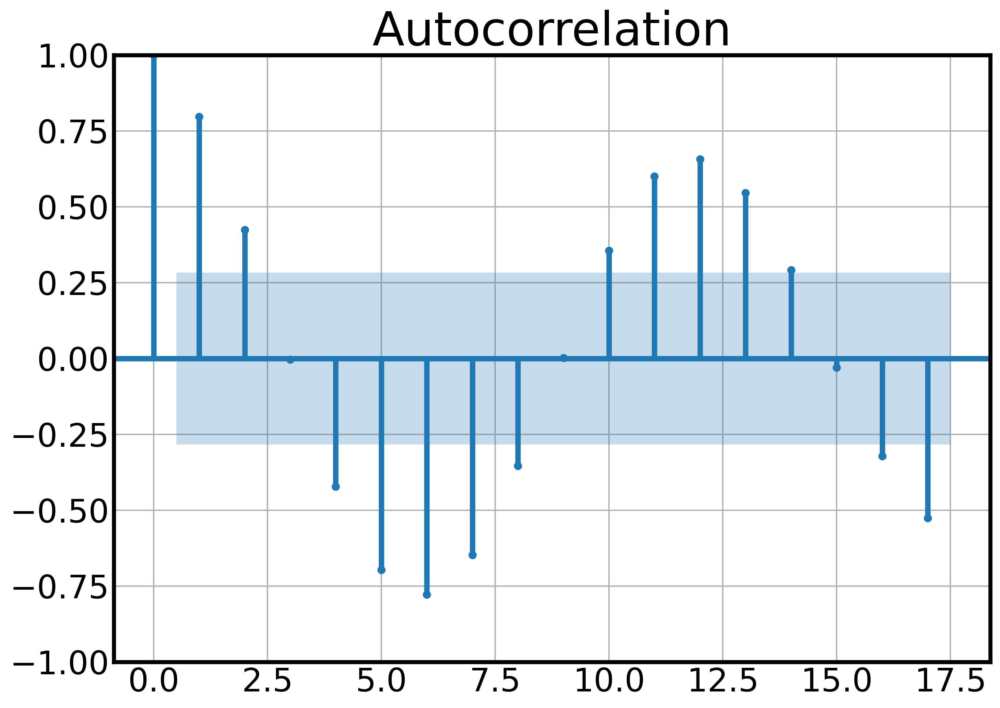

In [79]:
tsaplots.plot_acf(tempsm,bartlett_confint=False);

### Динамика внутри сезонных компонент

Второй вид графиков - это разбитый по сезонным компонентам график их изменения от времени 

In [80]:
temps = pd.read_csv('data/MtWashingtonDailyTemps.csv',index_col='DATE',parse_dates=True)
temps.index.freq = 'D'
temps.head()

,MinTemp,MaxTemp,AvgTemp,AvgWindSpeed,Sunrise,Sunset
DATE,,,,,,
2014-12-01,3,36,20,65.1,700,1608
2014-12-02,1,22,12,34.7,702,1607
2014-12-03,8,32,20,53.0,703,1607
2014-12-04,-5,9,2,60.2,704,1607
2014-12-05,6,17,12,30.5,705,1607


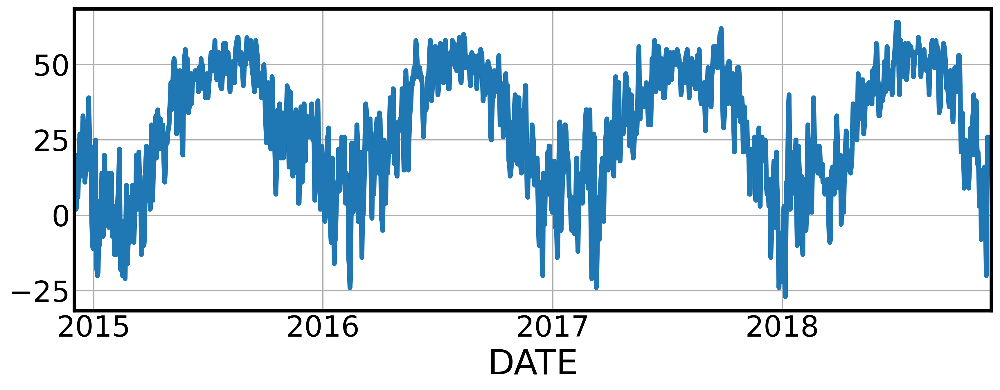

In [81]:
temps['AvgTemp'].plot(figsize=(12,5));

In [82]:
tempsm = temps['AvgTemp'].resample('M').mean()

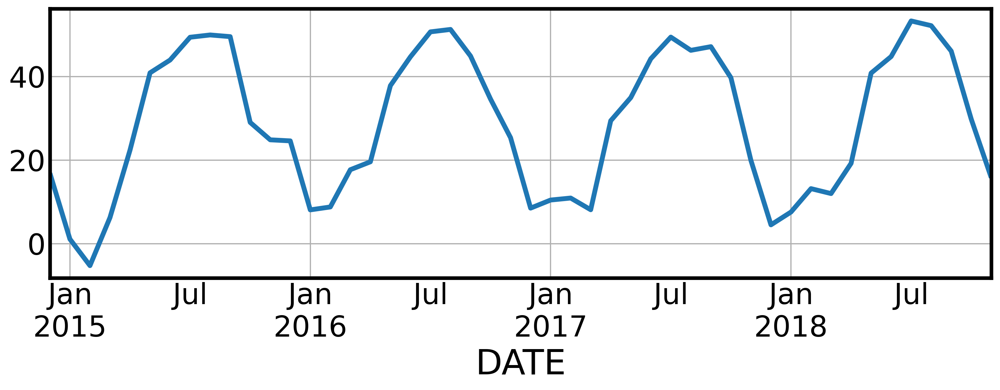

In [83]:
tempsm.plot(figsize=(12,5));

Здесь хорошо видны: 

    1) сама сезонность - средняя температура летом сильно выше, чем зимой.
    2) Сезонная компонента каждого месяца имеет свое случайное блуждание. Летние месяцы практически всегда около среднего, в то время как зимние месяцы каждый год довольно сильно меняют свою температуру

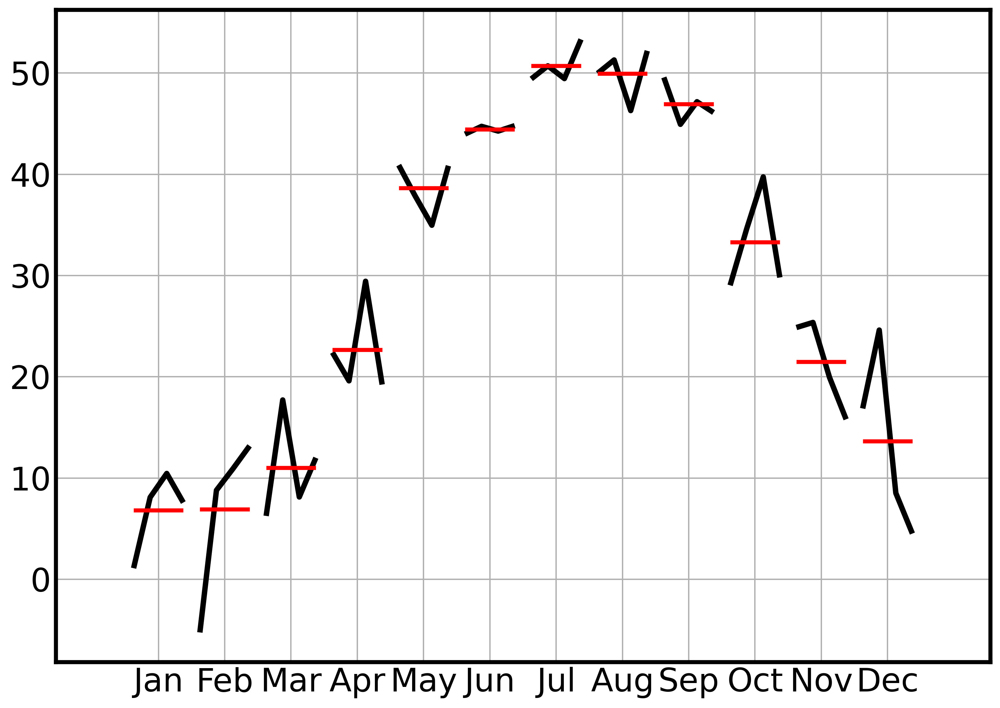

In [84]:
tsaplots.month_plot(tempsm);

In [85]:
airline = pd.read_csv('data/international-airline-passengers.csv', sep=';')
airline['Month'] = pd.to_datetime(airline['Month']+'-01')
airline.set_index('Month', inplace=True)

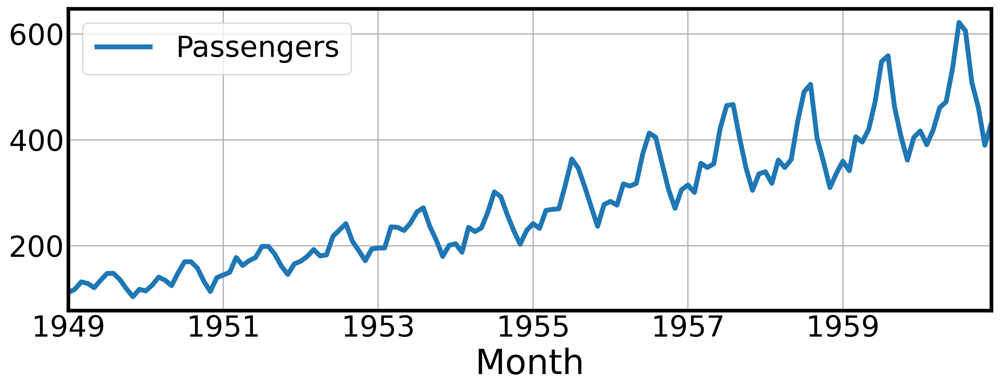

In [86]:
airline.plot(figsize=(12,5));

Здесь тренд доминирует над сезонностью, поэтому каждая компонента имеет ярко выраженный рост

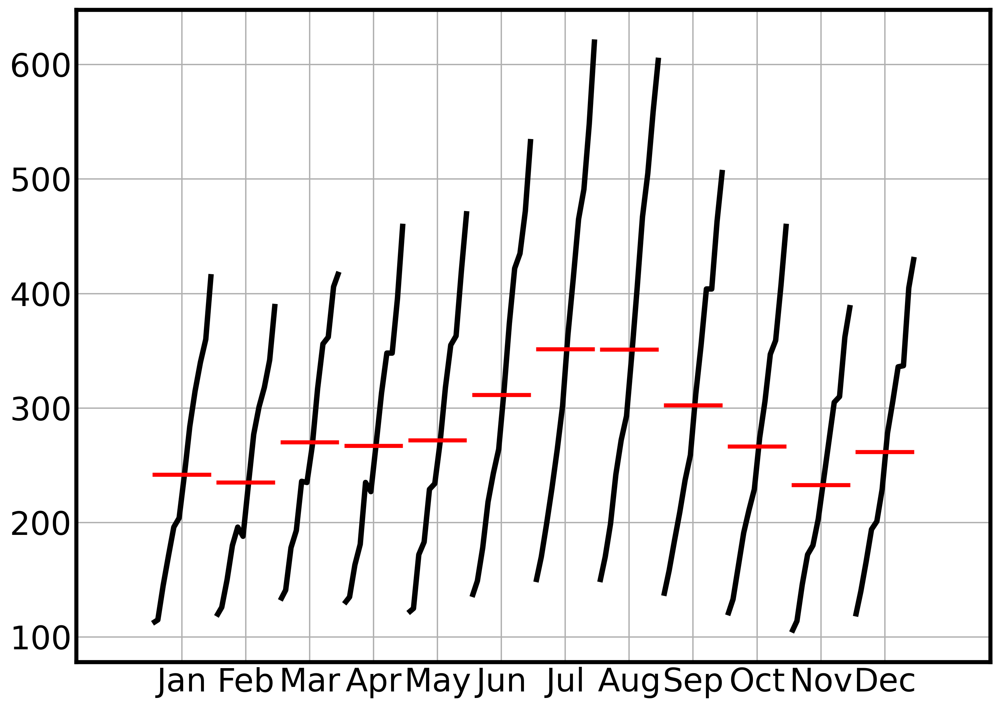

In [87]:
tsaplots.month_plot(airline);

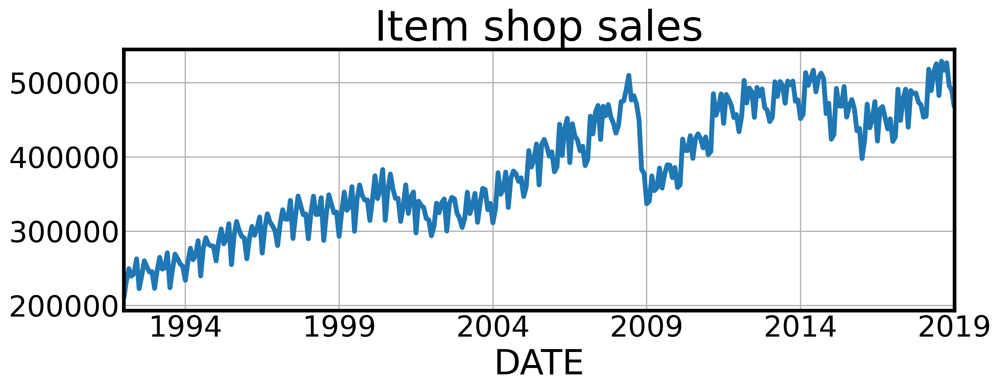

In [88]:
ax = shipment['UMTMVS'].plot(figsize=(12,5),title=title)

Здесь аналогично тренд доминирует над сезонностью, но даже при таких средних компоненты имеют разброс порядка 20%, что говорит о наличии сезонности в этом ряду

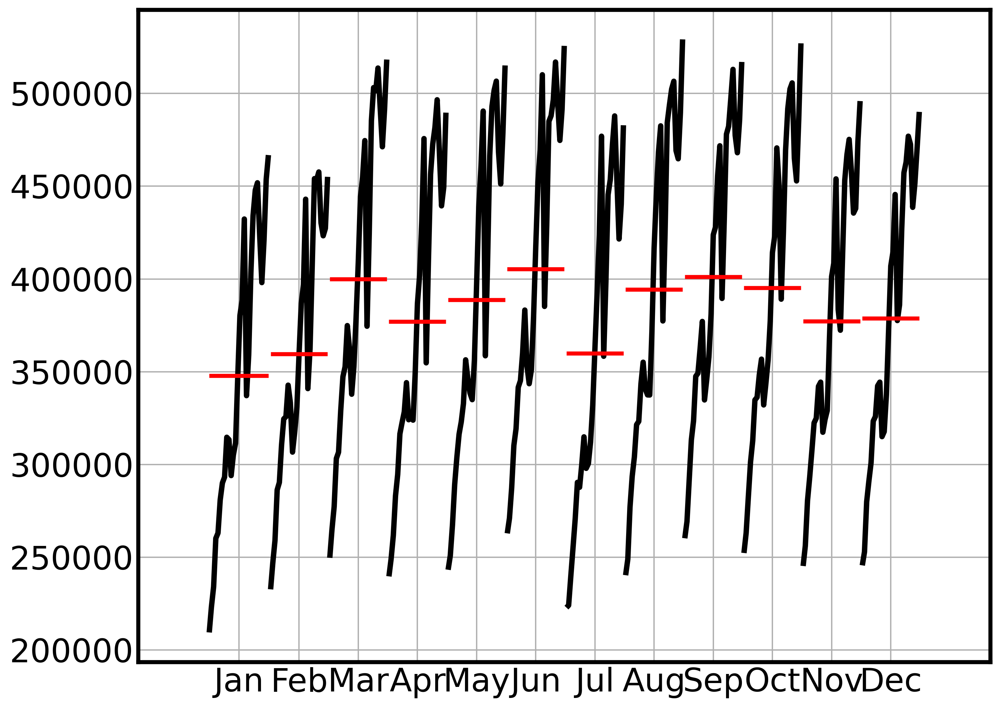

In [89]:
tsaplots.month_plot(shipment);

### Попериодная разбивка исходного ряда

Еще один способ графически показать сезонность - сделать разбивки по периоду (например, 1 год для месячных данных) и отобразить их линиями на одном графике 

In [90]:
airline['month'] = airline.index.month
airline['year'] = airline.index.year
cmap = sns.color_palette("rocket", as_cmap=False,n_colors=10)

In [91]:
airline.tail()

,Passengers,month,year
Month,,,
1960-08-01,606,8,1960
1960-09-01,508,9,1960
1960-10-01,461,10,1960
1960-11-01,390,11,1960
1960-12-01,432,12,1960


здесь четко видно что пики приходятся на одни и те же сезонные компоненты

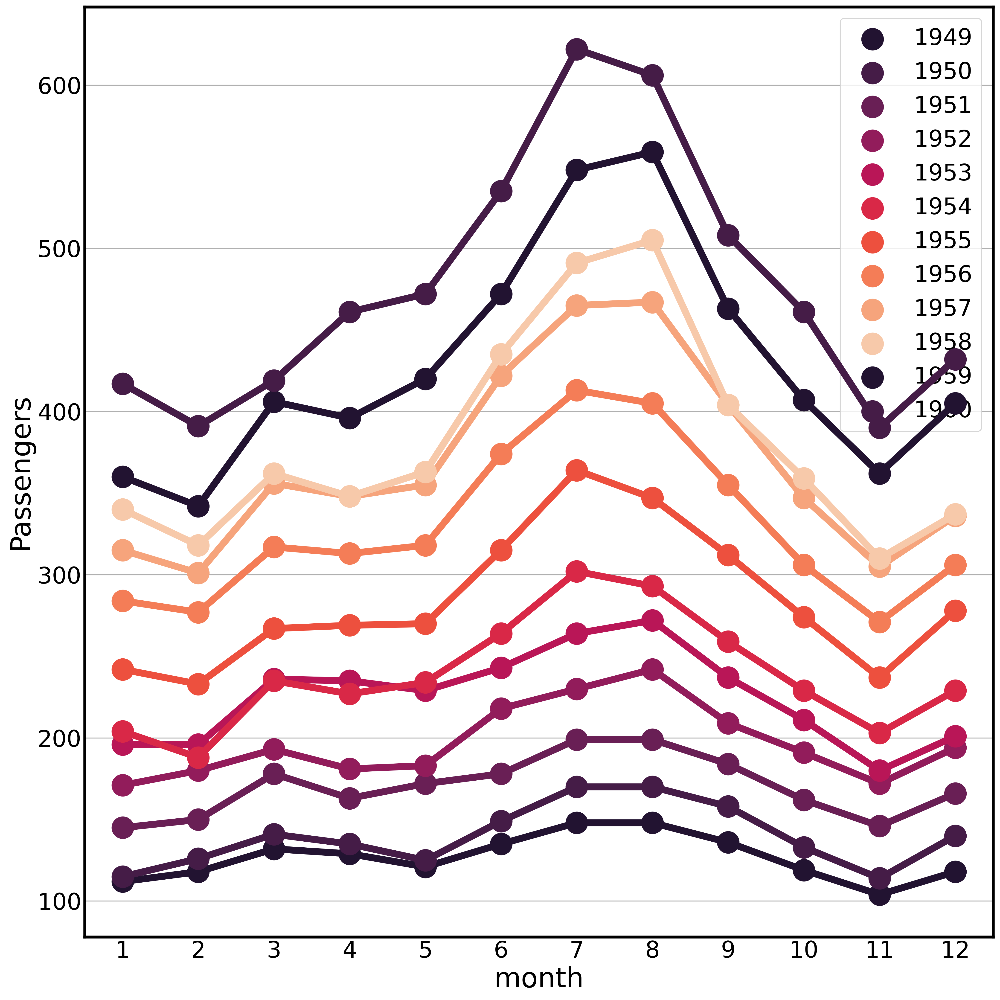

In [92]:
plt.figure(figsize=(15,15))
sns.pointplot(x="month", y="Passengers", hue="year", data=airline,palette=cmap)
plt.legend(loc='upper right')

In [93]:
Sun['num_s'] = Sun.index.year//11
Sun['s'] = Sun.index.year%11
cmap = sns.color_palette("rocket", as_cmap=False,n_colors=30)

а вот здесь такого не видно - часть линий достигает максимума на 0 месяц, часть - на 1й и на 10й, кроме того есть линии с пиками в 5й и 6й месяц, когда в другие периоды был спад

<Axes: xlabel='s', ylabel='SUNACTIVITY'>

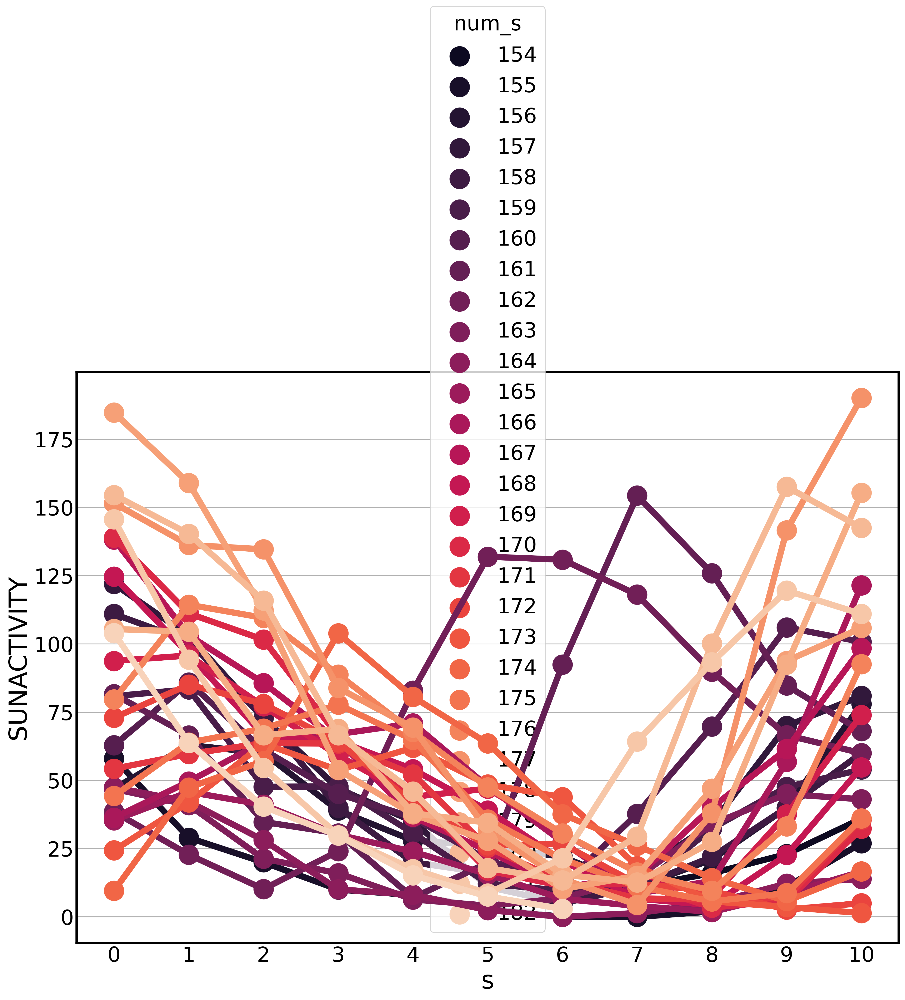

In [94]:
plt.figure(figsize=(15,15))
sns.pointplot(x="s", y="SUNACTIVITY", hue="num_s", data=Sun,palette=cmap)
#plt.legend(loc='upper right');

## Моделирование сезонных компонент

### Dummy-variables

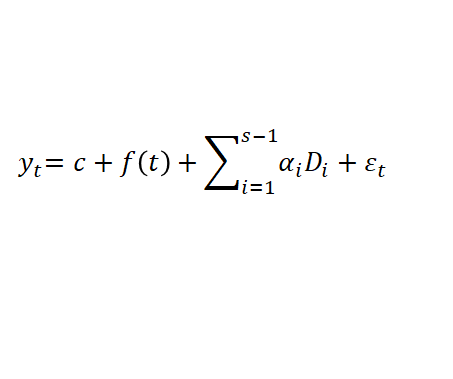

In [95]:
Sun = pd.read_csv('data/sun.csv')
Sun['YEAR'] = pd.to_datetime(Sun['YEAR'].astype(int).astype(str) + '-01-01')
Sun.set_index("YEAR",inplace=True)

In [96]:
x = pd.get_dummies((Sun.index.year%11).astype(str),prefix='s')

In [97]:
ses_pred = sm.OLS(Sun.values,x.values).fit().predict(x.values)

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


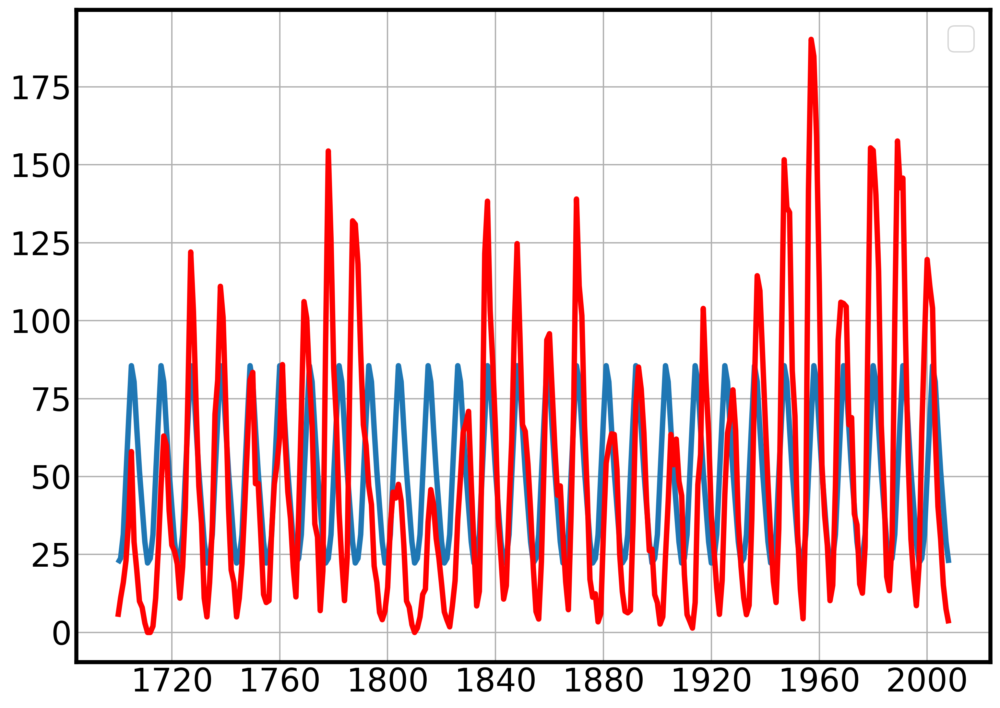

In [99]:
plt.plot(pd.Series(ses_pred,index=Sun.index))
plt.plot(Sun, c = 'red')
plt.legend()

In [100]:
x = pd.get_dummies((tempsm.index.month%12).astype(str),prefix='s')

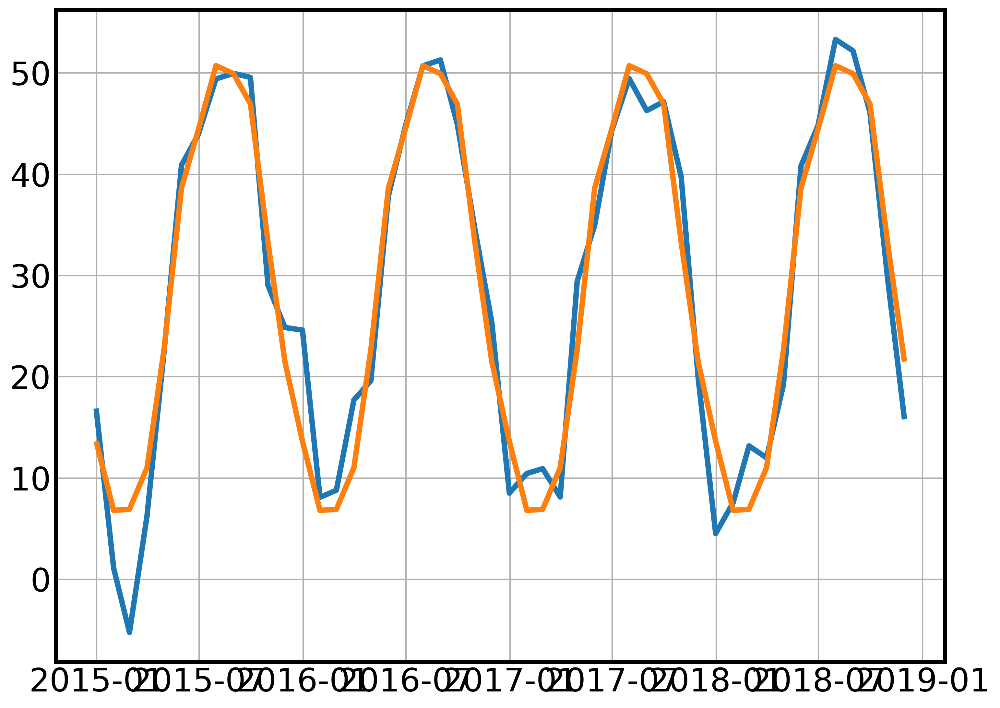

In [101]:
plt.plot(tempsm);
plt.plot(pd.Series(sm.OLS(tempsm.values,sm.add_constant(x.values)).fit().predict(sm.add_constant(x.values)),
                   index=tempsm.index))

In [102]:
airline = pd.read_csv('data/international-airline-passengers.csv', sep=';')
airline['Month'] = pd.to_datetime(airline['Month']+'-01')
airline.set_index('Month', inplace=True)

In [103]:
x = pd.get_dummies((airline.index.month%12).astype(str),prefix='s')

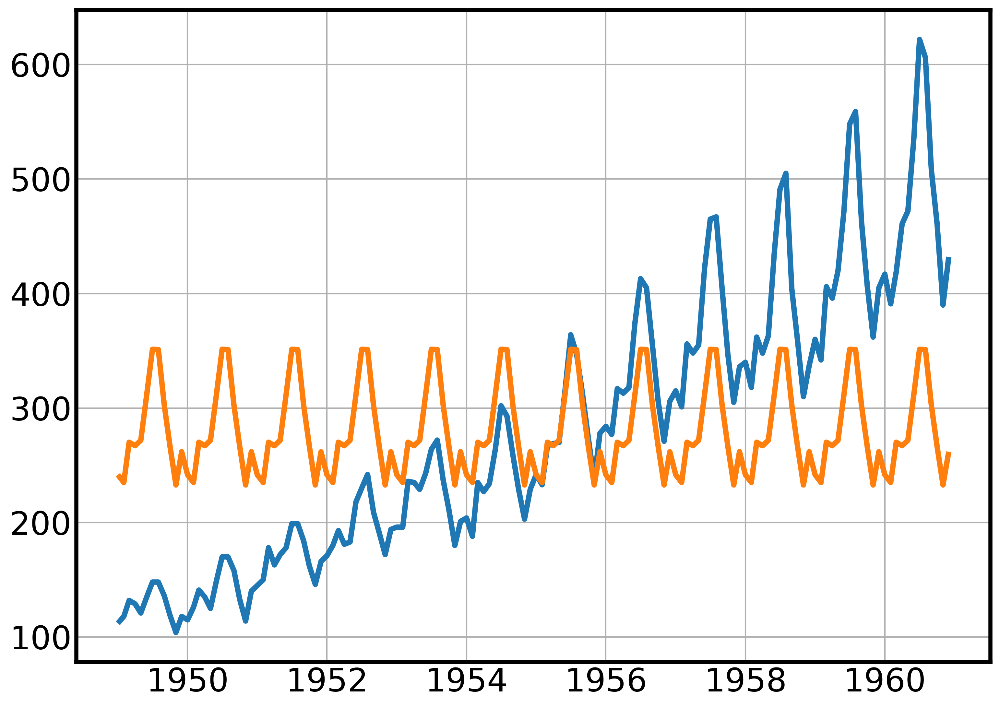

In [104]:
plt.plot(airline);
plt.plot(pd.Series(sm.OLS(airline.values,sm.add_constant(x.values)).fit().predict(sm.add_constant(x.values)),
                   index=airline.index))

In [105]:
x = pd.get_dummies((airline.index.month%12).astype(str),prefix='s')
x['trend'] = airline.index.year*12 + airline.index.month

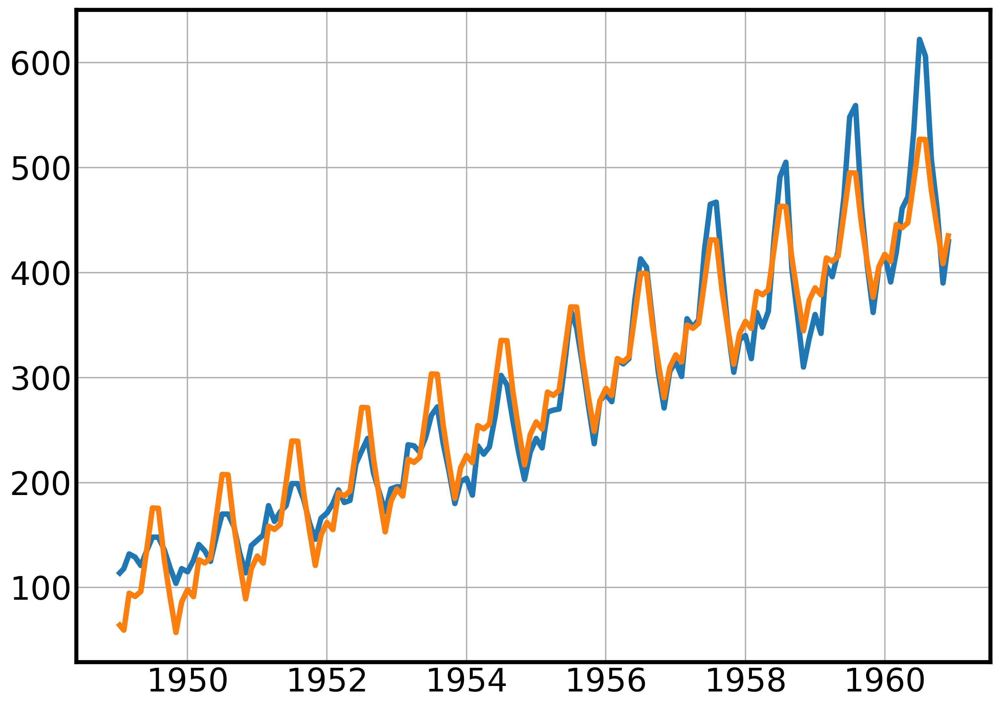

In [106]:
plt.plot(airline);
plt.plot(pd.Series(sm.OLS(airline.values,sm.add_constant(x.values)).fit().predict(sm.add_constant(x.values)),
                   index=airline.index))

### sin и cos

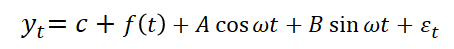

In [107]:
x = np.c_[np.sin(2*np.pi*(Sun.index.year.values%11)/11),np.cos(2*np.pi*(Sun.index.year.values%11)/11)]

In [108]:
ses_pred = sm.OLS(Sun.values,sm.add_constant(x)).fit().predict(sm.add_constant(x))

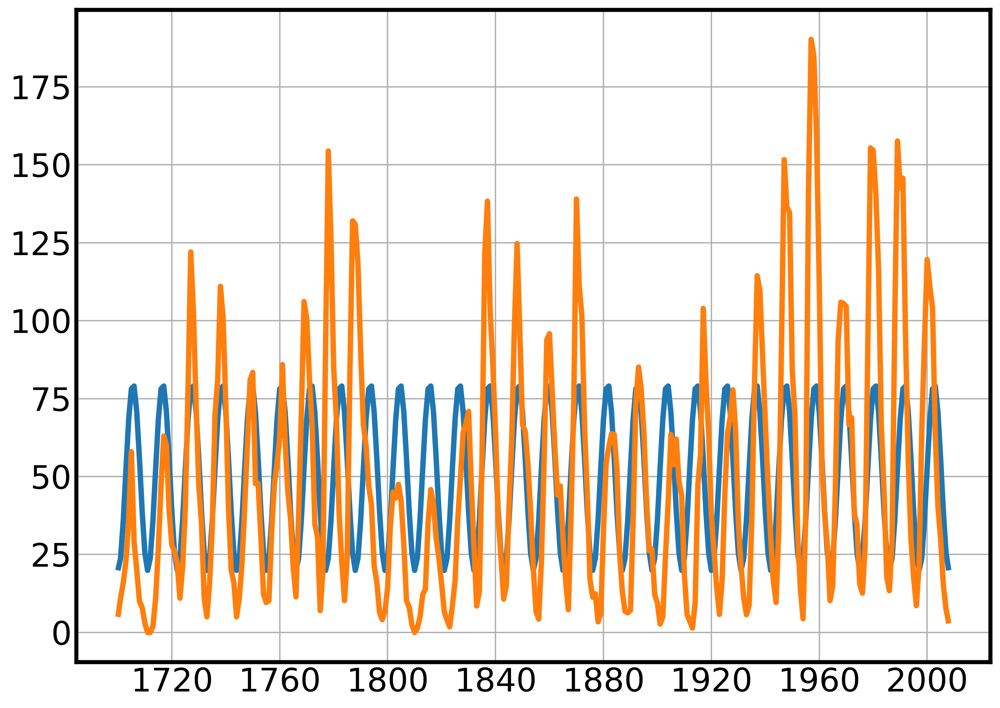

In [109]:
plt.plot(pd.Series(ses_pred,index=Sun.index))
plt.plot(Sun)

In [110]:
x = np.c_[np.sin(2*np.pi*(tempsm.index.month.values%12)/12),np.cos(2*np.pi*(tempsm.index.month.values%12)/12)]

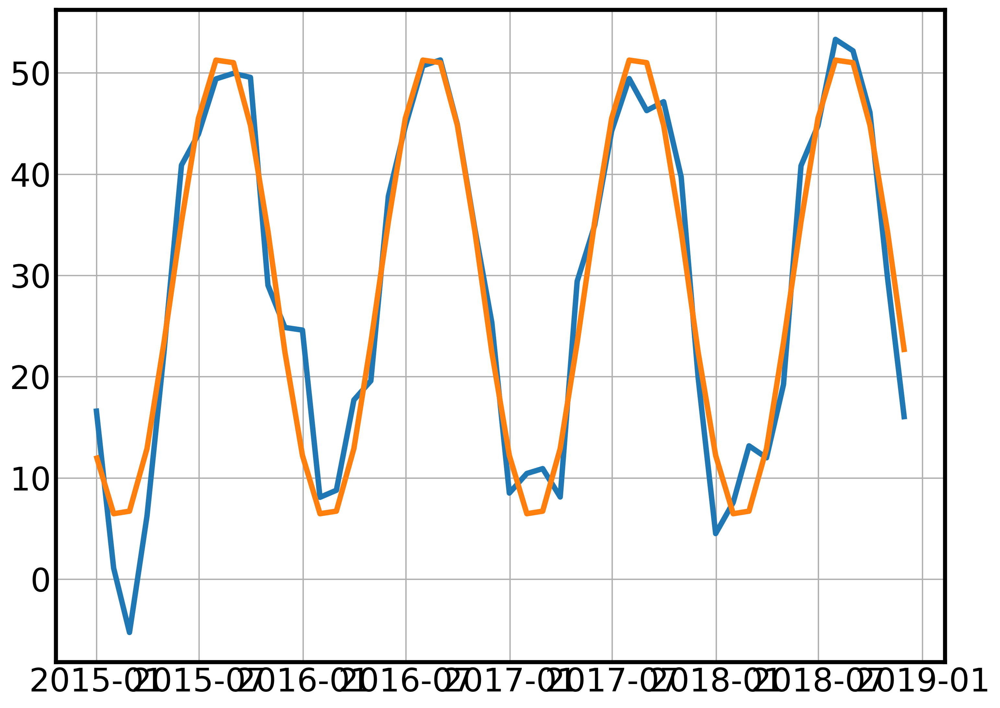

In [111]:
plt.plot(tempsm);
plt.plot(pd.Series(sm.OLS(tempsm.values,sm.add_constant(x)).fit().predict(sm.add_constant(x)),
                   index=tempsm.index))

## Приведение сезонного ряда к стационарному

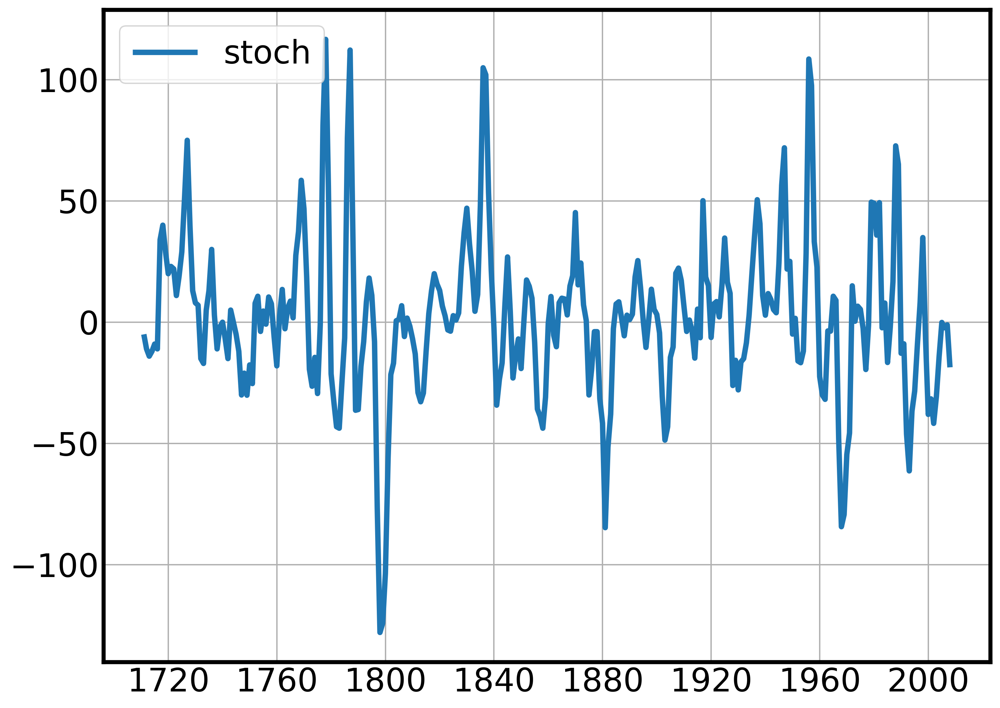

In [115]:
delta_determenistic = Sun.subtract(ses_pred,axis=0)
delta_stohastic = Sun - Sun.shift(11)

#plt.plot(delta_determenistic,label='dummy')
plt.plot(delta_stohastic,label='stoch')
plt.legend()

Операция дифференцирования приводит ряд к стационарному, в отличии от операции десезонализации с помощью тригонометрических функций

In [113]:
error_df = pd.DataFrame([[metr(tren)[1] for metr in stattests] for tren in [delta_determenistic,delta_stohastic.dropna()]],
            index=['dummy','stoch'],
            columns=[metr.__name__ for metr in stattests])

error_df

/tmp/ipykernel_2977705/3914005721.py:1: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  error_df = pd.DataFrame([[metr(tren)[1] for metr in stattests] for tren in [delta_determenistic,delta_stohastic.dropna()]],


,adfuller,kpss
dummy,0.057315,0.010689
stoch,0.000169,0.100000


# Инструменты одновременного выделения тренда и сезонности

In [116]:
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.tsa.seasonal import STL

## Классическая декомпозиция

В классической декомпозиции тренд оценивается скользящим средним с размером окна, равному сезонности (12 для месячных данных), сезонная компонента - как среднее по каждому месяцу после вычитания тренда из исходного вр.


### Аддитивная декомпозиция

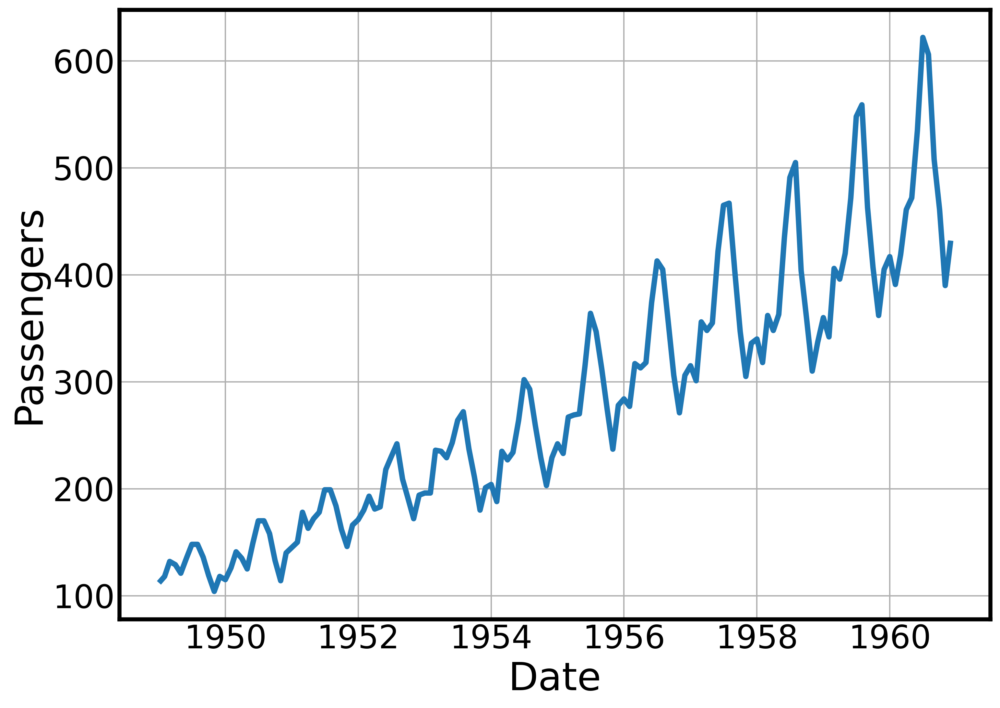

In [117]:
fig, ax = plt.subplots(1, 1)
ax.plot(airline.index, airline['Passengers'])
ax.set_xlabel('Date')
ax.set_ylabel('Passengers');

In [118]:
airline_add = seasonal_decompose(airline,
                                 model='additive',
                                 filt=None,
                                 period=12,
                                 two_sided=True,
                                 extrapolate_trend=1)

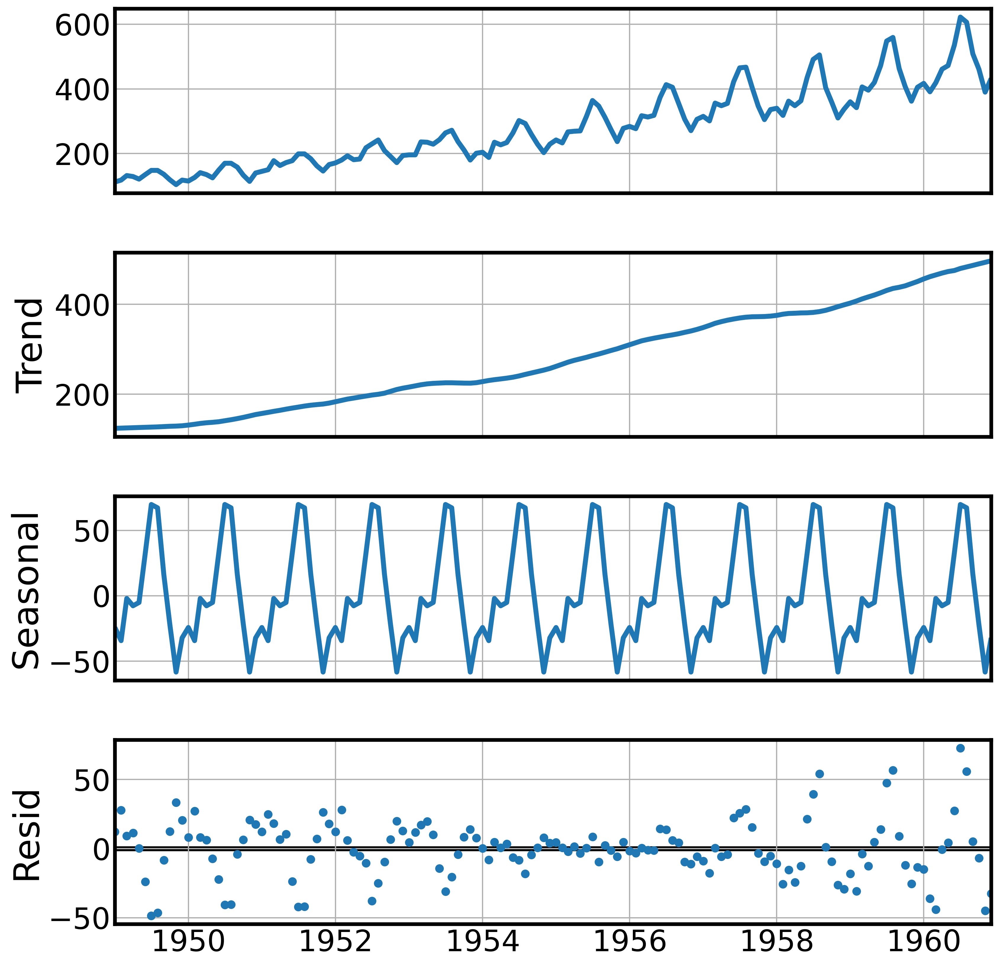

In [119]:
fig = airline_add.plot();
fig.set_size_inches((12,12))

<Axes: xlabel='Month'>

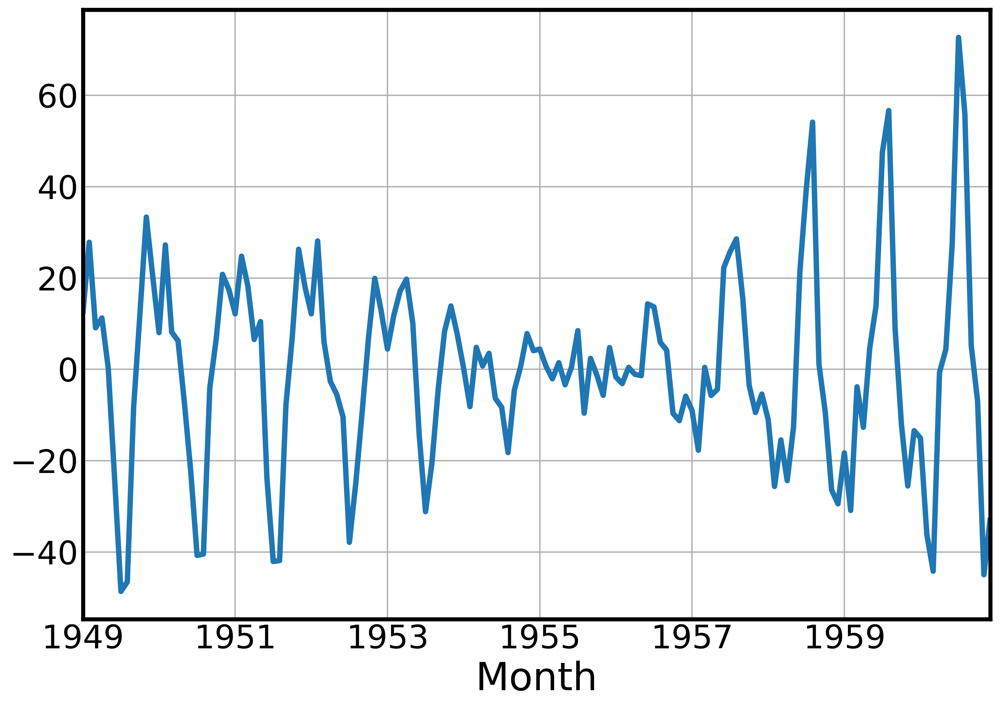

In [120]:
airline_add.resid.plot()

мы попробовали применить к ряду аддитивную декомпозицию, но глядя на ряд остатков видно, что полностью от сезонности избавится не получилось

### Мультипликативная декомпозиция

In [128]:
airline_mult = seasonal_decompose(airline,
                                  model='multiplicative',
                                  filt=None,
                                  period=12,
                                  two_sided=True,
                                  extrapolate_trend=1)

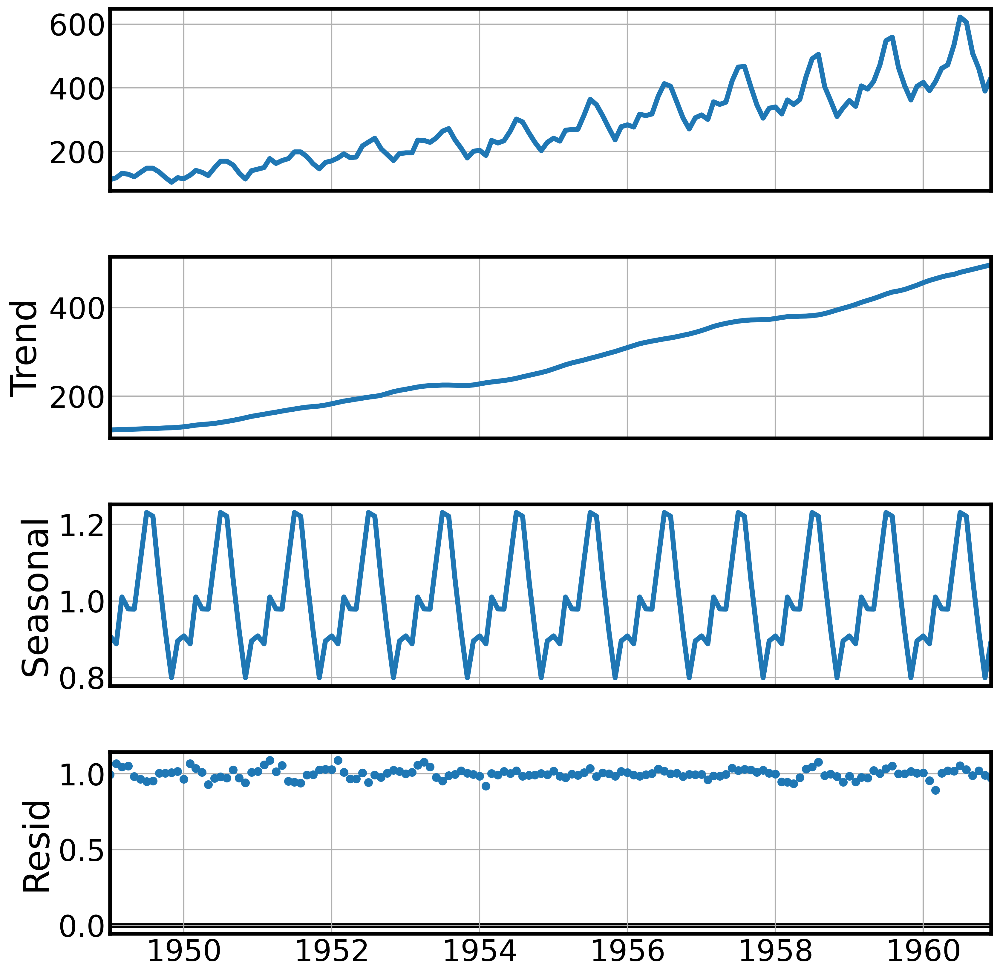

In [129]:
fig = airline_mult.plot();
fig.set_size_inches((12,12))

Для мультипликативной декомпозиции остатки выглядят гораздо лучше

<Axes: xlabel='Month'>

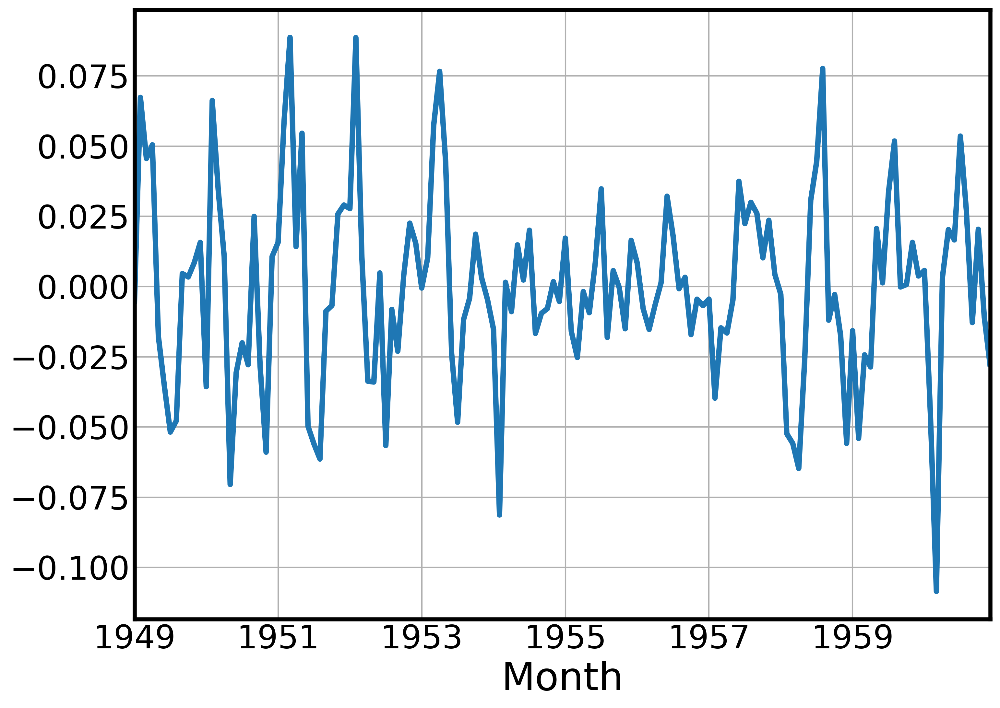

In [130]:
(airline_mult.resid-1).plot()

In [131]:
airline_mult.resid

Month
1949-01-01    0.993763
1949-02-01    1.067364
1949-03-01    1.045573
1949-04-01    1.050430
1949-05-01    0.982303
1949-06-01    0.964588
1949-07-01    0.948201
1949-08-01    0.952219
1949-09-01    1.004631
1949-10-01    1.003406
1949-11-01    1.008515
1949-12-01    1.015698
1950-01-01    0.964341
1950-02-01    1.066220
1950-03-01    1.034426
1950-04-01    1.010646
1950-05-01    0.929544
1950-06-01    0.969347
1950-07-01    0.979977
1950-08-01    0.972165
1950-09-01    1.024965
1950-10-01    0.971591
1950-11-01    0.941048
1950-12-01    1.010658
1951-01-01    1.015675
1951-02-01    1.058808
1951-03-01    1.088674
1951-04-01    1.014251
1951-05-01    1.054579
1951-06-01    0.950266
1951-07-01    0.943956
1951-08-01    0.938595
1951-09-01    0.991243
1951-10-01    0.993265
1951-11-01    1.025818
1951-12-01    1.029019
1952-01-01    1.027734
1952-02-01    1.088612
1952-03-01    1.010522
1952-04-01    0.966307
1952-05-01    0.966012
1952-06-01    1.004838
1952-07-01    0.943411
1952-

### Фиксируем левостороннее окно

Один из важнейших параметров для классической декомпозиции - это параметр two_sided. Если two_sided=True, то скользящее средние считается по точкам, находящимся как справа, так и слева, и только по точкам слева, если two_sided=False. В результате при two_sided=True вы гораздо лучше оценивает тренд (остатки выглядят как белый шум, но у вас остается незаполненными последние период(12)/2 = 6 значений, и для прогноза на 1 шаг вам придется экстраполировать тренд на 7 значений вперед.

In [136]:
airline_mult_left = seasonal_decompose(airline,
                                       model='multiplicative',
                                       filt=None,
                                       period=12,
                                       two_sided=False,
                                       extrapolate_trend=0)

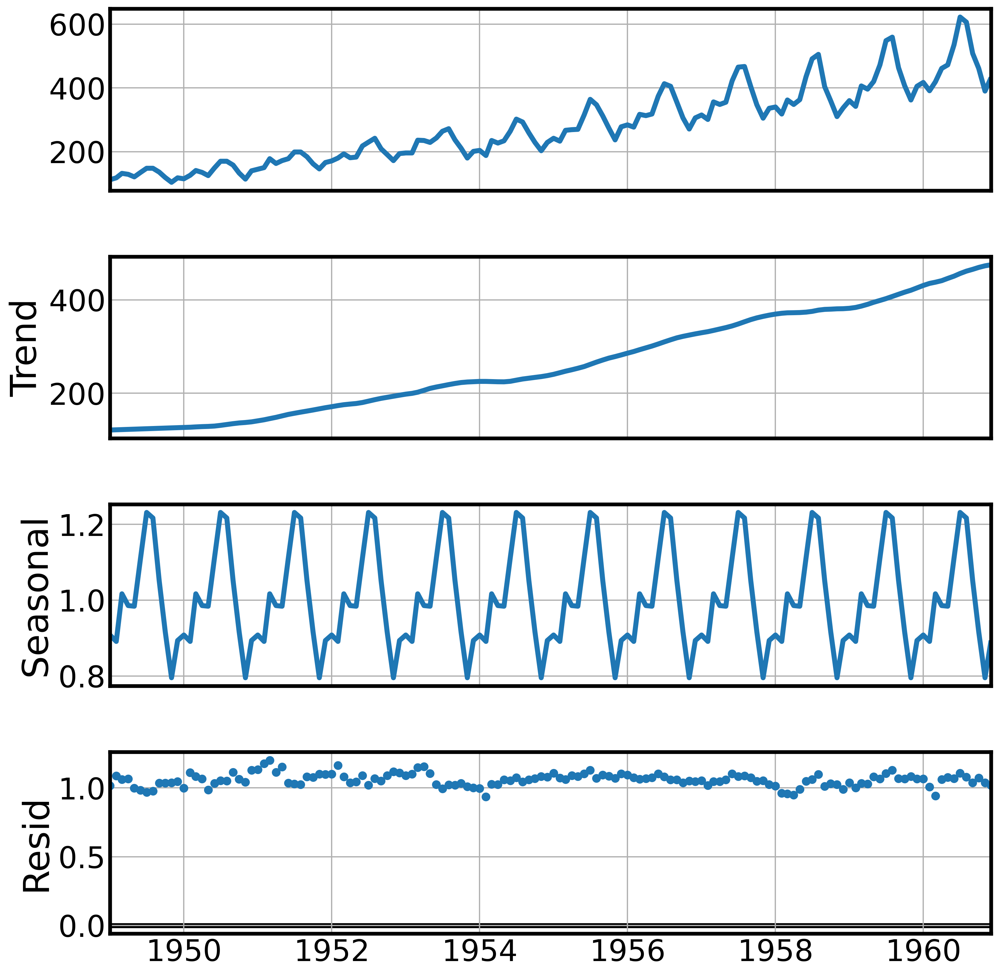

In [133]:
fig = airline_mult_left.plot();
fig.set_size_inches((12,12))

<Axes: xlabel='Month'>

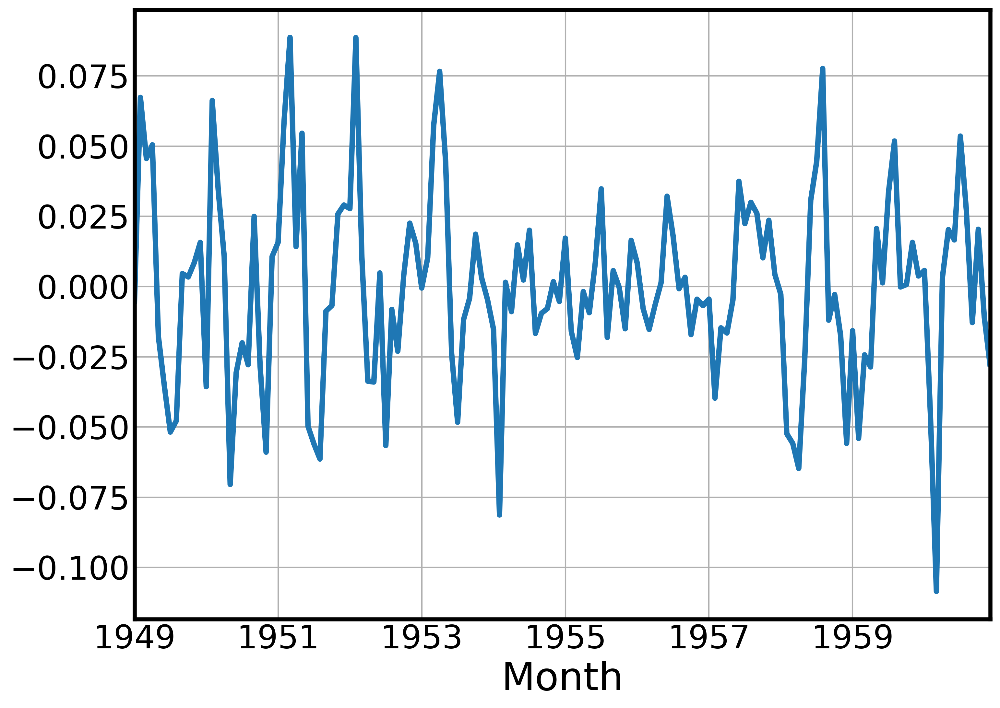

In [130]:
(airline_mult.resid-1).plot()

<Axes: xlabel='Month'>

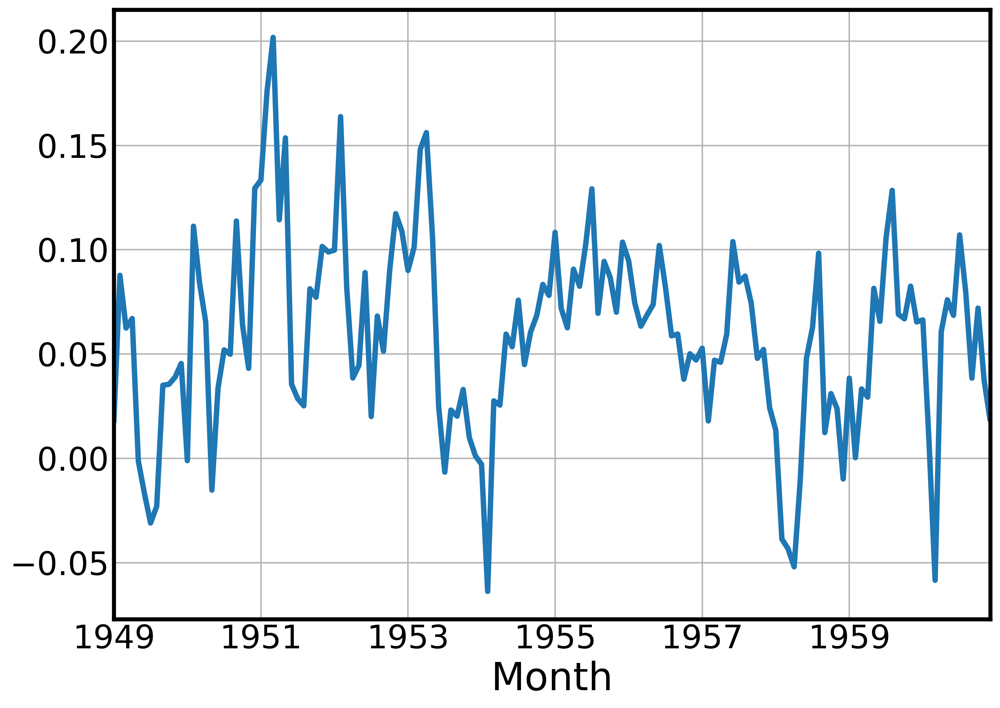

In [126]:
(airline_mult_left.resid-1).plot()

In [137]:
airline_mult_left.resid

Month
1949-01-01         NaN
1949-02-01         NaN
1949-03-01         NaN
1949-04-01         NaN
1949-05-01         NaN
1949-06-01         NaN
1949-07-01         NaN
1949-08-01         NaN
1949-09-01         NaN
1949-10-01         NaN
1949-11-01         NaN
1949-12-01         NaN
1950-01-01    0.998492
1950-02-01    1.117443
1950-03-01    1.087630
1950-04-01    1.069322
1950-05-01    0.982818
1950-06-01    1.030083
1950-07-01    1.047192
1950-08-01    1.045836
1950-09-01    1.114893
1950-10-01    1.065207
1950-11-01    1.044620
1950-12-01    1.131600
1951-01-01    1.132773
1951-02-01    1.182393
1951-03-01    1.205775
1951-04-01    1.118573
1951-05-01    1.151196
1951-06-01    1.032048
1951-07-01    1.023963
1951-08-01    1.021216
1951-09-01    1.082409
1951-10-01    1.078425
1951-11-01    1.103055
1951-12-01    1.101045
1952-01-01    1.099266
1952-02-01    1.170245
1952-03-01    1.085710
1952-04-01    1.042494
1952-05-01    1.042515
1952-06-01    1.085364
1952-07-01    1.015446
1952-

In [131]:
airline_mult.resid

Month
1949-01-01    0.993763
1949-02-01    1.067364
1949-03-01    1.045573
1949-04-01    1.050430
1949-05-01    0.982303
1949-06-01    0.964588
1949-07-01    0.948201
1949-08-01    0.952219
1949-09-01    1.004631
1949-10-01    1.003406
1949-11-01    1.008515
1949-12-01    1.015698
1950-01-01    0.964341
1950-02-01    1.066220
1950-03-01    1.034426
1950-04-01    1.010646
1950-05-01    0.929544
1950-06-01    0.969347
1950-07-01    0.979977
1950-08-01    0.972165
1950-09-01    1.024965
1950-10-01    0.971591
1950-11-01    0.941048
1950-12-01    1.010658
1951-01-01    1.015675
1951-02-01    1.058808
1951-03-01    1.088674
1951-04-01    1.014251
1951-05-01    1.054579
1951-06-01    0.950266
1951-07-01    0.943956
1951-08-01    0.938595
1951-09-01    0.991243
1951-10-01    0.993265
1951-11-01    1.025818
1951-12-01    1.029019
1952-01-01    1.027734
1952-02-01    1.088612
1952-03-01    1.010522
1952-04-01    0.966307
1952-05-01    0.966012
1952-06-01    1.004838
1952-07-01    0.943411
1952-

Для двухстрононнего окна первые 6 значений и последние 6 значений не заполнены, т.к. для них недостаточно наблюдений, чтобы считать среднее

### Применение фильтров для сглаживания тренда

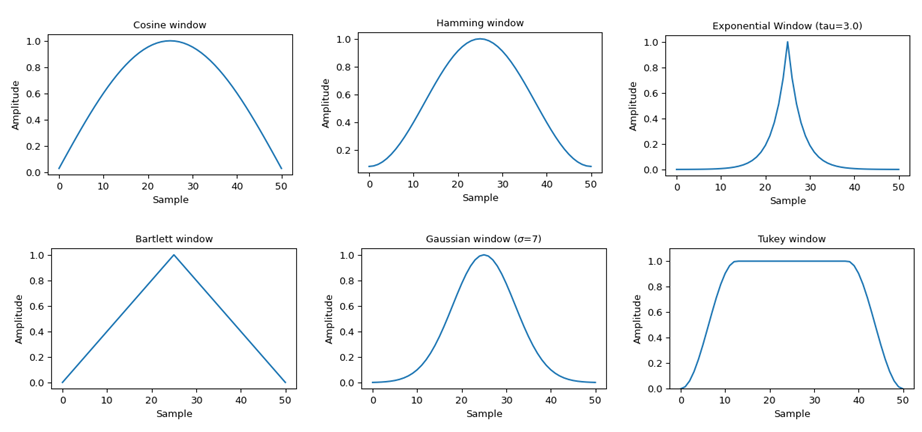

In [138]:
from scipy.signal import windows as wind

In [139]:
airline_mult_filt = seasonal_decompose(airline,
                                       model='multiplicative',
                                       filt=wind.bartlett(25)/np.sum(wind.bartlett(25)),
                                       period=12,
                                       two_sided=True,
                                       extrapolate_trend=0)

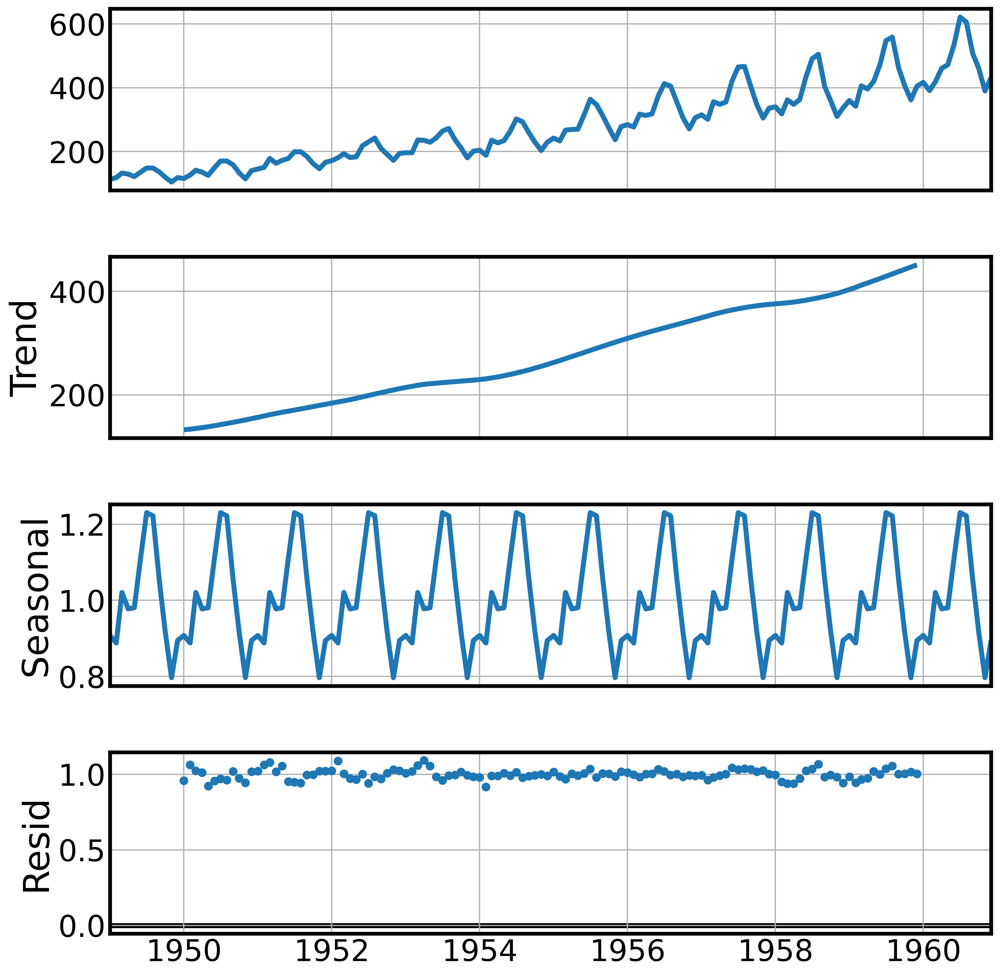

In [140]:
fig = airline_mult_filt.plot();
fig.set_size_inches((12,12))

<Axes: xlabel='Month'>

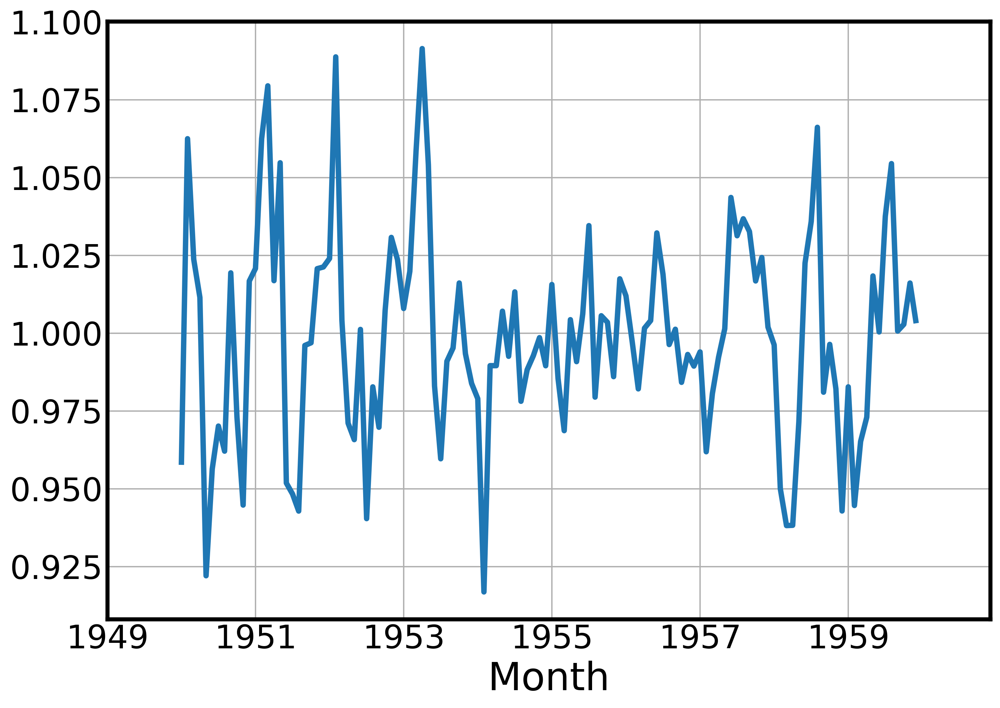

In [141]:
airline_mult_filt.resid.plot()

In [142]:
cur_wind = wind.bohman(23)

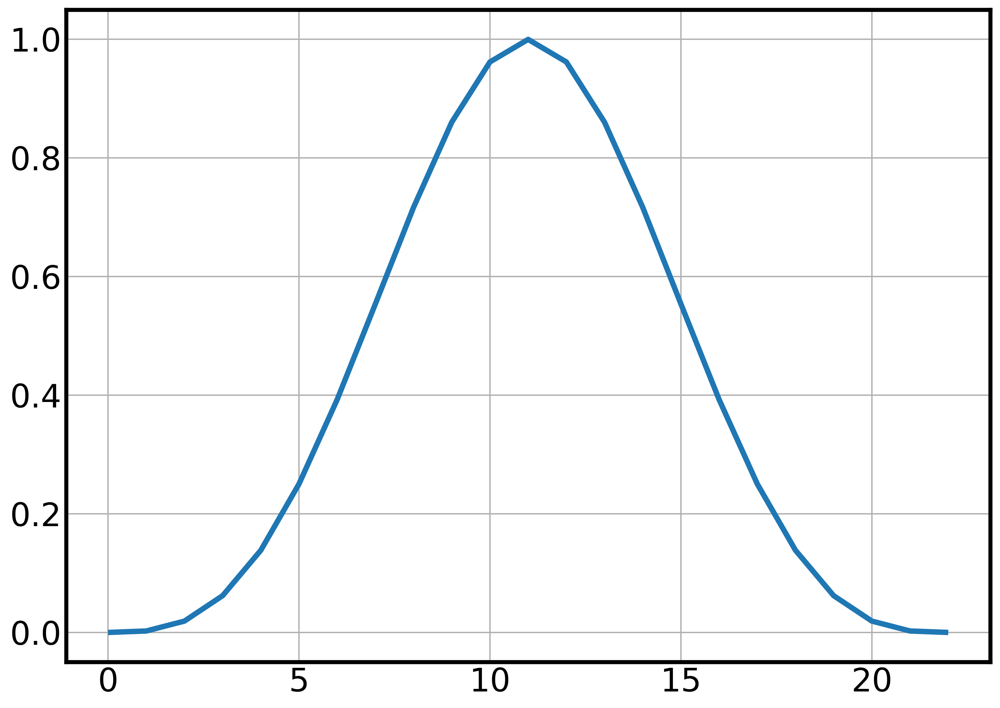

In [143]:
plt.plot(cur_wind)

In [144]:
airline_mult_filt1 = seasonal_decompose(airline,
                                       model='multiplicative',
                                       filt=cur_wind/np.sum(cur_wind),
                                       period=12,
                                       two_sided=True,
                                       extrapolate_trend=0)

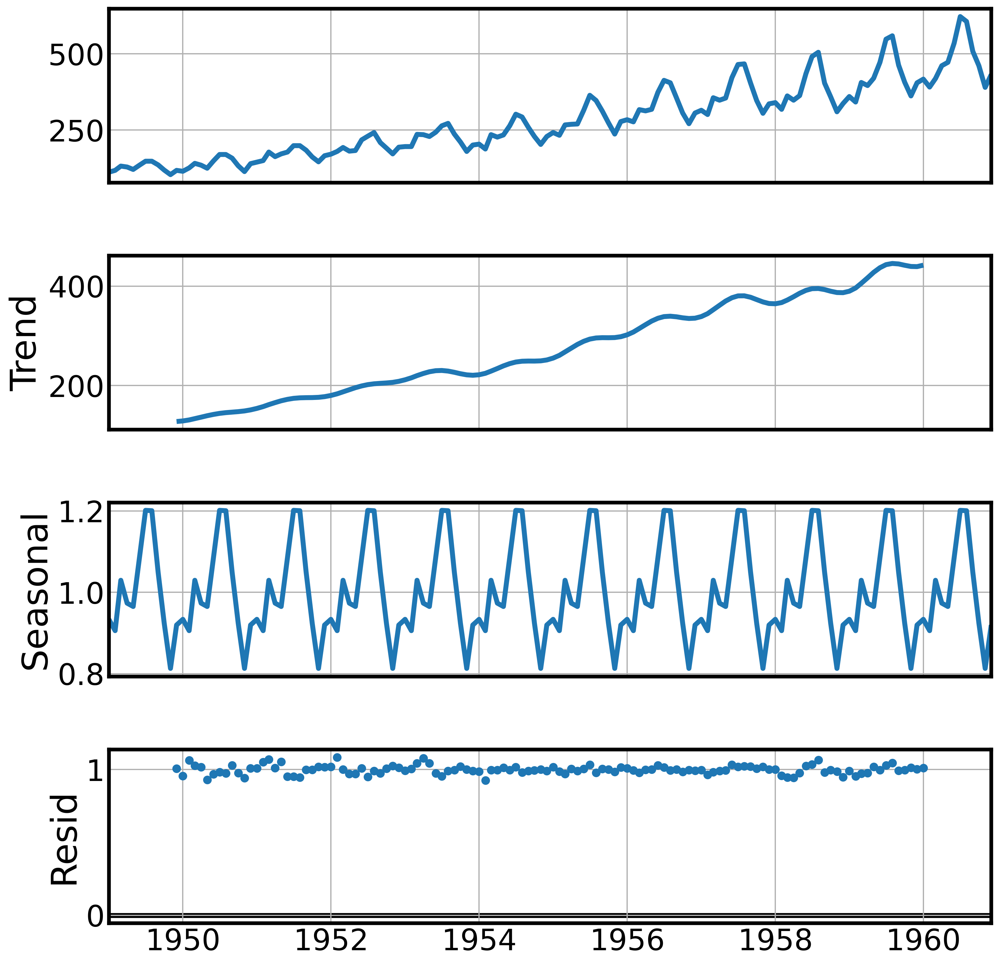

In [145]:
fig = airline_mult_filt1.plot();
fig.set_size_inches((12,12))

<Axes: xlabel='Month'>

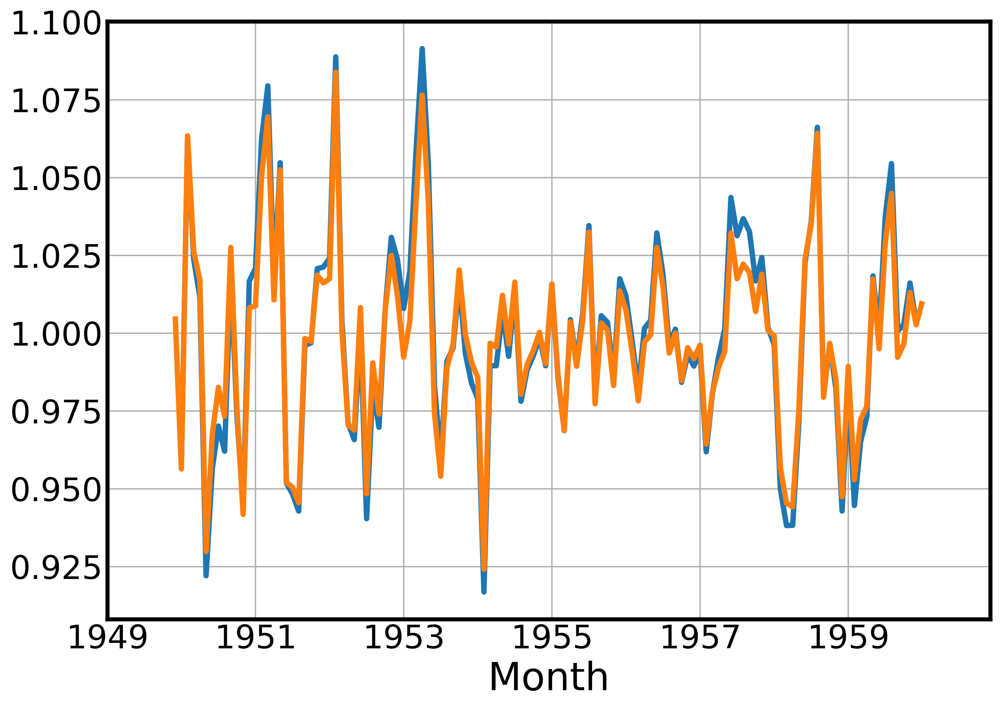

In [146]:
airline_mult_filt.resid.plot()
airline_mult_filt1.resid.plot()

In [ ]:
airline_mult_filt.trend.plot()
#airline_mult_filt1.trend.plot()
airline_mult.trend.plot()

## STL-декомпозиция

### Аддитивная декомпозиция ряда

In [149]:
airline_stl_decomp = STL(airline, period=12, seasonal_deg=2)
#airline_stl_decomp = airline_stl_decomp.fit()

Основные параметры stl: seasonal - ширина окна для усреднения сезонносной компоненты (сколько точек входит для оценки сезонной компоненты), seasonal_deg - что обучаем(0 - константа, 1 - линейная), seasonal_jump - шаг линейной интерполяции (если больше 1, то обучаемся не на всех точках, а на каждой второй, третей и т.д.) 

In [150]:
airline_stl_decomp.config

{'period': 12,
 'seasonal': 7,
 'seasonal_deg': 2,
 'seasonal_jump': 1,
 'trend': 23,
 'trend_deg': 1,
 'trend_jump': 1,
 'low_pass': 13,
 'low_pass_deg': 1,
 'low_pass_jump': 1,
 'robust': False}

In [151]:
airline_stl_decomp = airline_stl_decomp.fit()

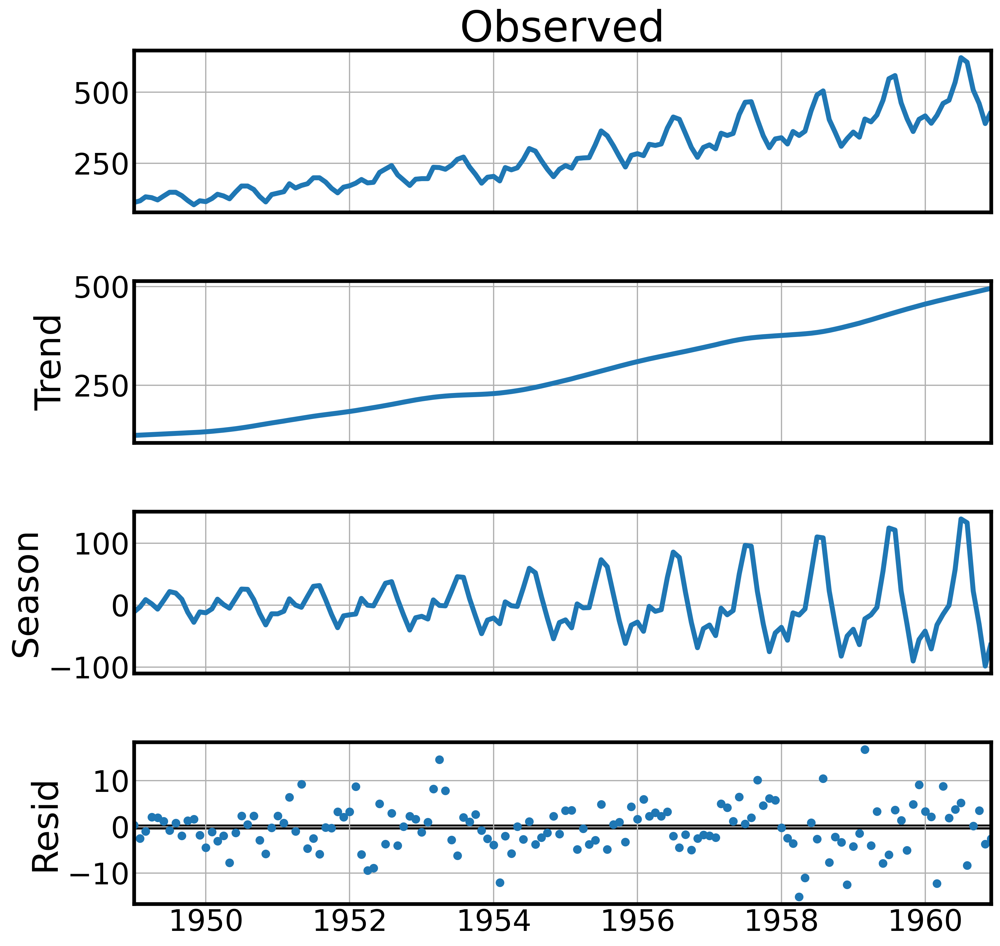

In [152]:
fig = airline_stl_decomp.plot();
fig.set_size_inches((12,12))

<Axes: xlabel='Month'>

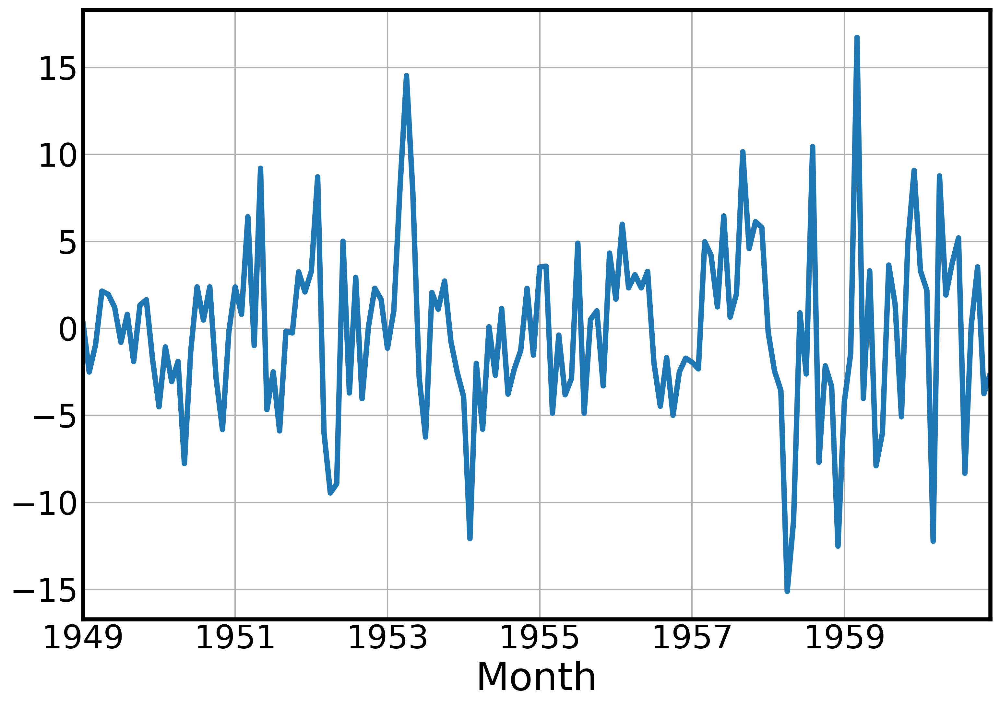

In [153]:
airline_stl_decomp.resid.plot()

по сути, оценка сезонных компонент в stl - это отдельная lowess-регрессия на каждый месяц по детрендированному временному ряду.


In [154]:
from statsmodels.nonparametric.smoothers_lowess import lowess

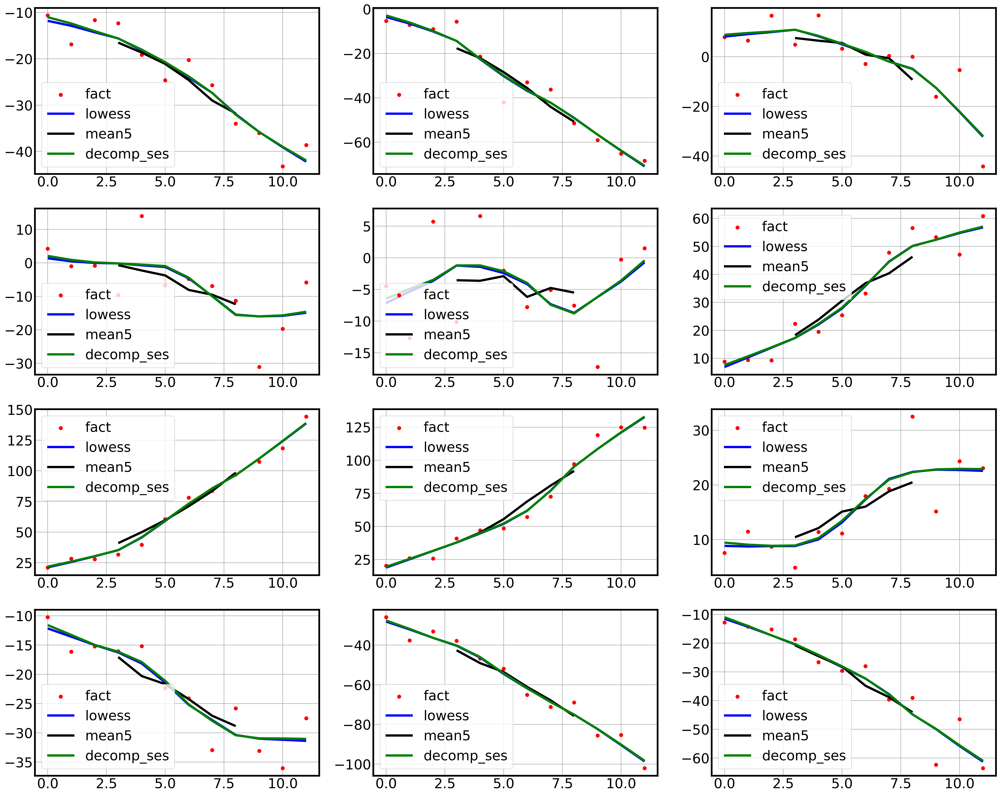

In [169]:
fig,ax = plt.subplots(4,3,figsize=(25,20))
for i in range(12):
    cur_row = airline.subtract(airline_stl_decomp.trend.values,axis=0)[airline.index.month==i+1]
    x = np.array(list(range(len(cur_row))))
    ses_approx = lowess(cur_row.values.reshape(-1,),
                        x,
                        it=0,
                        frac=7/len(cur_row),return_sorted =False)
    
    ax[i//3][i%3].scatter(x, cur_row.values.reshape(-1,), c = 'red',label = 'fact')
    
    ax[i//3][i%3].plot(x,ses_approx,c='blue',label='lowess')
    
    ax[i//3][i%3].plot(x,
        cur_row.rolling(7,center=True).mean().values,c='black',label='mean5')
    
    ax[i//3][i%3].plot(x,
                       airline_stl_decomp.seasonal[airline.index.month==i+1].values,
                       c='green',label='decomp_ses')
    
    ax[i//3][i%3].legend();

### Модификация работы STL с выбросами

потестим, как работает stl на выбросах

In [156]:
airline_corrupt = airline.copy()
airline_corrupt.loc["1954-08-01"] +=150

<Axes: xlabel='Month'>

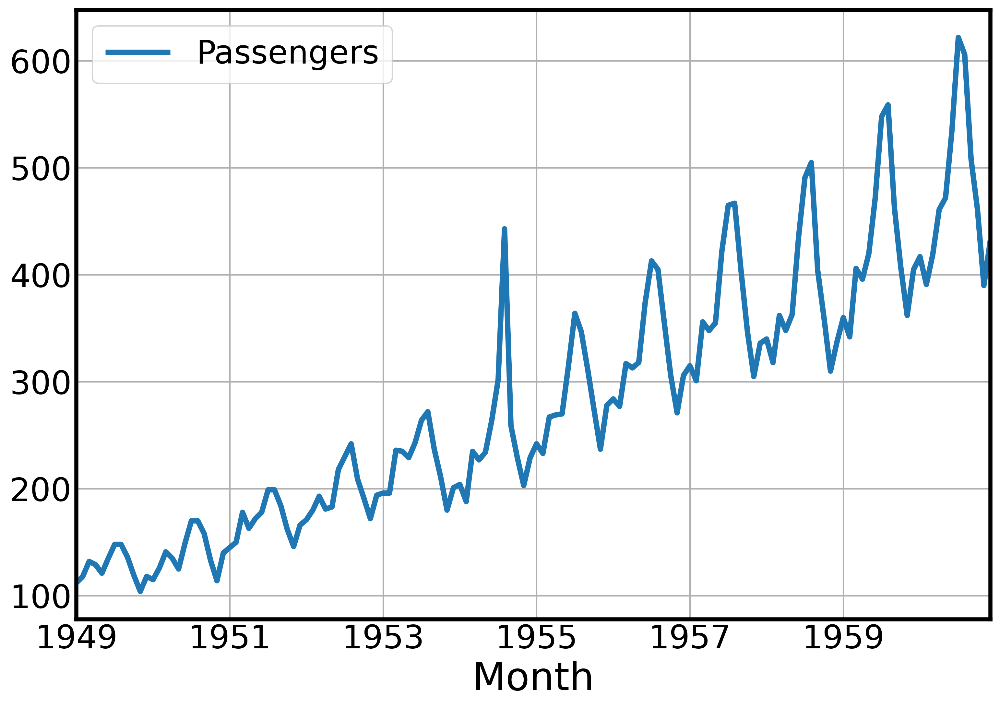

In [157]:
airline_corrupt.plot()

за робастность stl отвечает параметр robust. При robust=False оценка весов для каждой точки не делается

In [158]:
airline_corrupt_non_robust_stl_decomp = STL(airline_corrupt,period=12,robust=False).fit()

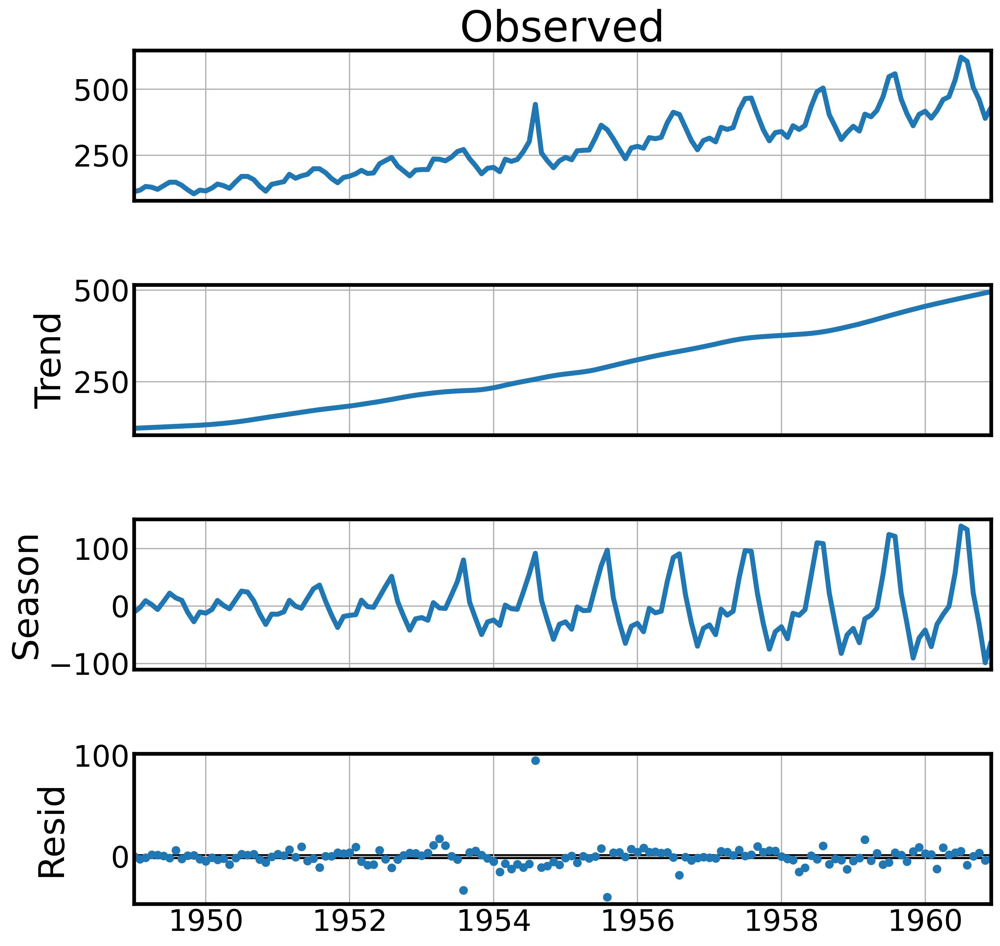

In [159]:
fig = airline_corrupt_non_robust_stl_decomp.plot();
fig.set_size_inches((12,12))

loess реагирует на выброс (3й ряд, центральный график)

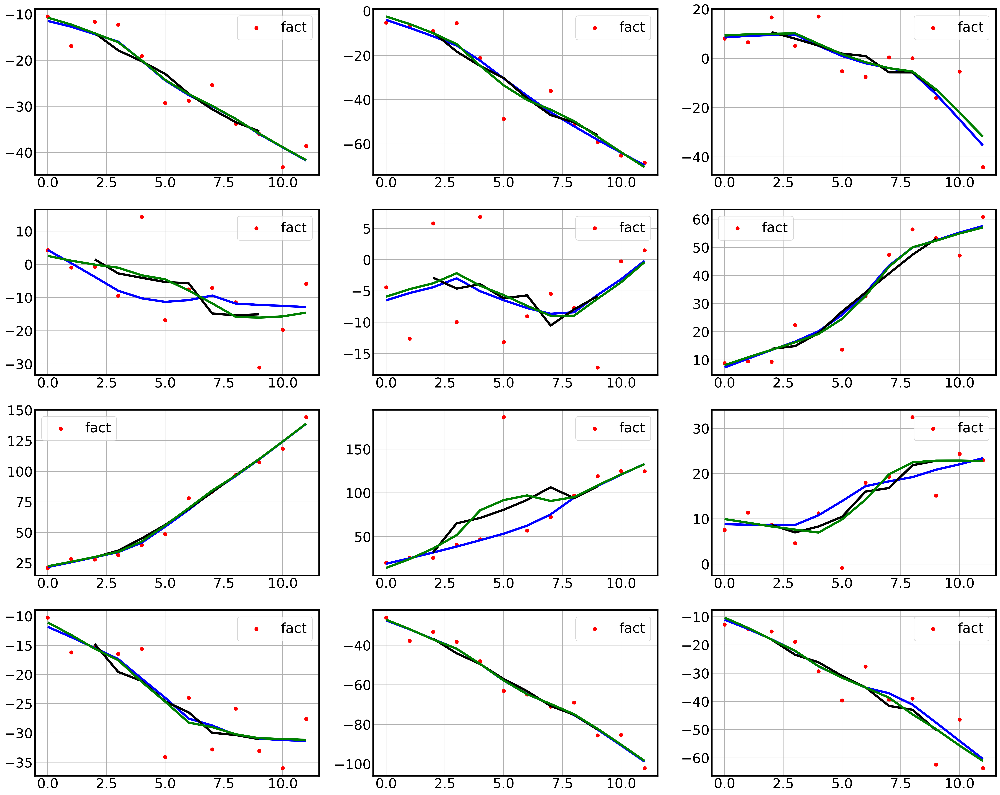

In [162]:
fig,ax = plt.subplots(4,3,figsize=(25,20))
lowess_list = []
for i in range(12):
    cur_row = airline_corrupt.subtract(airline_corrupt_non_robust_stl_decomp.trend.values,axis=0)[airline_corrupt.index.month==i+1]
    x = np.array(list(range(len(cur_row))))
    ses_approx = lowess(cur_row.values.reshape(-1,),
                        x,
                        frac=7/len(cur_row),return_sorted =False)
    
    ax[i//3][i%3].scatter(x, cur_row.values.reshape(-1,), c = 'red',label = 'fact')
    
    ax[i//3][i%3].plot(x,ses_approx,c='blue')
    
    ax[i//3][i%3].plot(x,
        cur_row.rolling(5,center=True).mean().values,c='black')
    ax[i//3][i%3].legend();
    
    ax[i//3][i%3].plot(x,
                       airline_corrupt_non_robust_stl_decomp.seasonal[airline_corrupt.index.month==i+1].values,
                       c='green')
    #ax[i//3][i%3].legend();
    #ax[i//3][i%3].get_legend().remove()

In [163]:
airline_corrupt_robust_stl_decomp = STL(airline_corrupt,period=12,robust=True).fit()

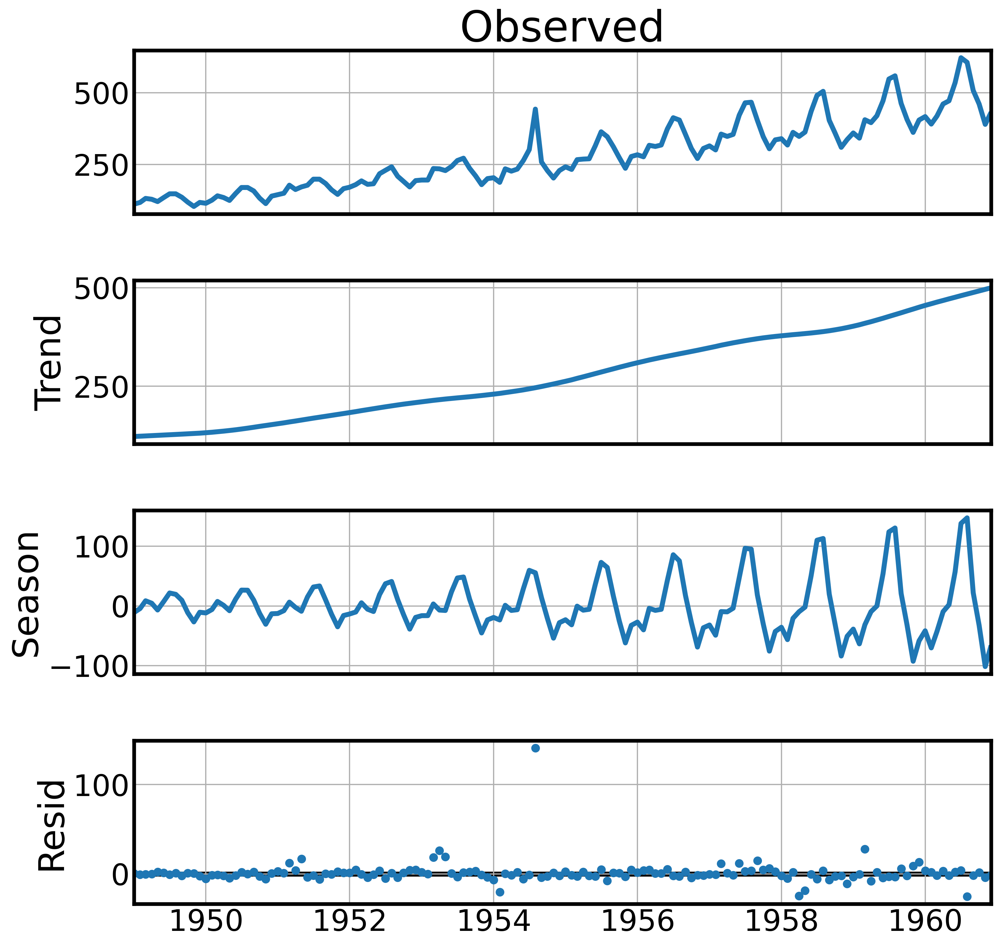

In [164]:
fig = airline_corrupt_robust_stl_decomp.plot();
fig.set_size_inches((12,12))

А здесь уже не реагирует

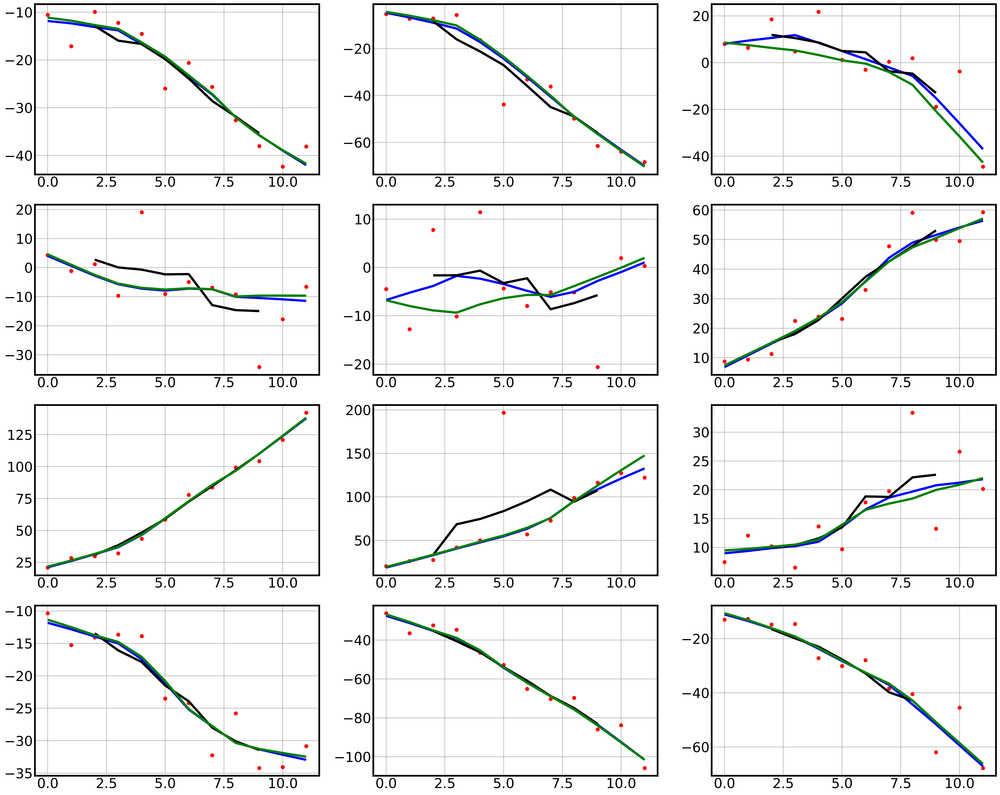

In [165]:
fig,ax = plt.subplots(4,3,figsize=(25,20))
lowess_list = []
for i in range(12):
    cur_row = airline_corrupt.subtract(airline_corrupt_robust_stl_decomp.trend.values,axis=0)[airline_corrupt.index.month==i+1]
    x = np.array(list(range(len(cur_row))))
    ses_approx = lowess(cur_row.values.reshape(-1,),
                        x,
                        frac=7/len(cur_row),return_sorted =False)
    
    ax[i//3][i%3].scatter(x, cur_row.values.reshape(-1,), c = 'red',label = 'fact')
    
    ax[i//3][i%3].plot(x,ses_approx,c='blue',label='lowess')
    
    ax[i//3][i%3].plot(x,
        cur_row.rolling(5,center=True).mean().values,c='black',label='moving_average')
    ax[i//3][i%3].legend();
    
    ax[i//3][i%3].plot(x,
                       airline_corrupt_robust_stl_decomp.seasonal[airline_corrupt.index.month==i+1].values,
                       c='green',label='decomp_ses')
    ax[i//3][i%3].legend();
    ax[i//3][i%3].get_legend().remove()

Сравнение весов для каждого наблюдения - для робастного и неробастного алгоритмов

<Axes: xlabel='Month'>

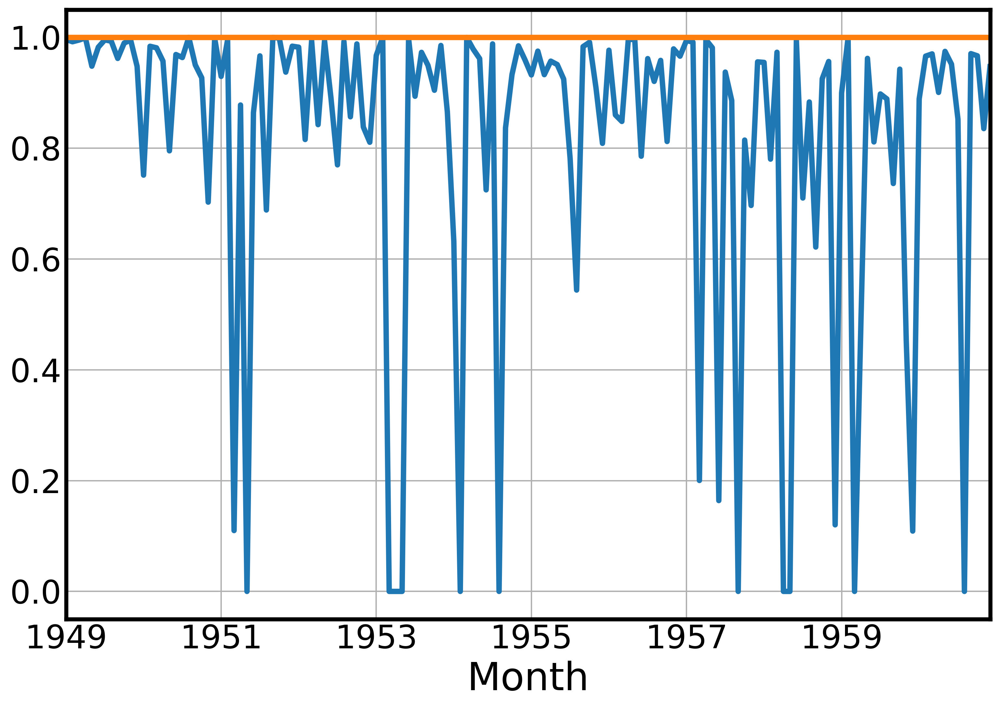

In [166]:
airline_corrupt_robust_stl_decomp.weights.plot()
airline_corrupt_non_robust_stl_decomp.weights.plot()